In [ ]:
!pip install tensorboardX

In [ ]:
import os
import glob
import torch
from torch.utils.data import Dataset
import matplotlib.pyplot as plt
import numpy as np
import cv2
from torch.utils.data import DataLoader
import torch
import torch.nn as nn
from torch.autograd import Variable
import torch.utils.data as Data
import torch.nn.functional as F
import torchvision
from torchvision.models.vgg import vgg16
from tensorboardX import SummaryWriter
import numpy as np
import random
import time
import pylab
from skimage.measure import compare_psnr, compare_ssim
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
class RainDataset(Dataset):
    def __init__(self, opt):
        super(RainDataset, self).__init__()
        self.dataset=opt
        self.img_list = sorted(glob.glob(self.dataset+'/data/*'))
        self.gt_list = sorted(glob.glob(self.dataset+'/gt/*'))
   
    def __len__(self):
        return len(self.img_list)

    def __getitem__(self, idx):
        img_name = self.img_list[idx]
        gt_name = self.gt_list[idx]

        img = cv2.imread(img_name,-1)
        gt = cv2.imread(gt_name,-1)

        img = cv2.resize(img, (224,224), interpolation=cv2.INTER_AREA)
        gt = cv2.resize(gt, (224,224), interpolation=cv2.INTER_AREA)
        # img = np.asarray(img).transpose((2,0,1))
        # gt = np.asarray(gt).transpose((2,0,1))

        if img.dtype == np.uint8:
            img = (img / 255.0).astype('float32')
        if gt.dtype == np.uint8:
            gt = (gt / 255.0).astype('float32')

        return [img,gt]

In [ ]:
!gdown --id 1FaQ0U6NPwQr5MKdHaf7419XEaYDJDYdi --output train.zip

In [ ]:
!unzip train.zip

In [ ]:
!gdown --id 1R6WfCEglbwTNDPYOhESAt80Lu5Ecz5dI --output test_a.zip

In [ ]:
!unzip test_a.zip

In [ ]:
!gdown --id 13enNbqbcjWJvwiUtbrRgJLFnihrQ6GlG --output test_b.zip

In [ ]:
!unzip test_b.zip

In [ ]:
train_dataset=RainDataset('train/')
valid_dataset=RainDataset('test_a/')
test_dataset=RainDataset('test_b/')

In [ ]:
batch_size=1
lr=0.0002
iter=200

In [ ]:
train_loader=DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
valid_loader=DataLoader(valid_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
len(train_loader),len(valid_loader)

(861, 58)

In [ ]:
img1=train_dataset.__getitem__(10)[0]
gt1=train_dataset.__getitem__(10)[1]
fig = plt.figure(figsize=(5,5))
plt.imshow(img1)
plt.show()

In [ ]:
fig = plt.figure(figsize=(5,5))
plt.imshow(gt1)
plt.show()

In [ ]:
ITERATION = 4

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.det_conv0 = nn.Sequential(
            nn.Conv2d(4, 32, 3, 1, 1),
            nn.ReLU() # LeakyReLU(0.2)
            )
        self.det_conv1 = nn.Sequential(
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU(),
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU()
            )
        self.det_conv2 = nn.Sequential(
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU(),
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU()
            )
        self.det_conv3 = nn.Sequential(
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU(),
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU()
            )
        self.det_conv4 = nn.Sequential(
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU(),
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU()
            )
        self.det_conv5 = nn.Sequential(
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU(),
            nn.Conv2d(32, 32, 3, 1, 1),
            nn.ReLU()
            )
        self.conv_i = nn.Sequential(
            nn.Conv2d(32 + 32, 32, 3, 1, 1),
            nn.Sigmoid()
            )
        self.conv_f = nn.Sequential(
            nn.Conv2d(32 + 32, 32, 3, 1, 1),
            nn.Sigmoid()
            )
        self.conv_g = nn.Sequential(
            nn.Conv2d(32 + 32, 32, 3, 1, 1),
            nn.Tanh()
            )
        self.conv_o = nn.Sequential(
            nn.Conv2d(32 + 32, 32, 3, 1, 1),
            nn.Sigmoid()
            )
        self.det_conv_mask = nn.Sequential(
            nn.Conv2d(32, 1, 3, 1, 1),
            )
        self.conv1 = nn.Sequential(
            nn.Conv2d(4, 64, 5, 1, 2),
            nn.ReLU()
            )
        self.conv2 = nn.Sequential(
            nn.Conv2d(64, 128, 3, 2, 1),
            nn.ReLU()
            )
        self.conv3 = nn.Sequential(
            nn.Conv2d(128, 128, 3, 1, 1),
            nn.ReLU()
            )
        self.conv4 = nn.Sequential(
            nn.Conv2d(128, 256, 3, 2, 1),
            nn.ReLU()
            )
        self.conv5 = nn.Sequential(
            nn.Conv2d(256, 256, 3, 1, 1),
            nn.ReLU()
            )
        self.conv6 = nn.Sequential(
            nn.Conv2d(256, 256, 3, 1, 1),
            nn.ReLU()
            )
        self.diconv1 = nn.Sequential(
            nn.Conv2d(256, 256, 3, 1, 2, dilation = 2),
            nn.ReLU()
            )
        self.diconv2 = nn.Sequential(
            nn.Conv2d(256, 256, 3, 1, 4, dilation = 4),
            nn.ReLU()
            )
        self.diconv3 = nn.Sequential(
            nn.Conv2d(256, 256, 3, 1, 8, dilation = 8),
            nn.ReLU()
            )
        self.diconv4 = nn.Sequential(
            nn.Conv2d(256, 256, 3, 1, 16, dilation = 16),
            nn.ReLU()
            )
        self.conv7 = nn.Sequential(
            nn.Conv2d(256, 256, 3, 1, 1),
            nn.ReLU()
            )
        self.conv8 = nn.Sequential(
            nn.Conv2d(256, 256, 3, 1, 1),
            nn.ReLU()
            )
        self.deconv1 = nn.Sequential(
            nn.ConvTranspose2d(256, 128, 4, 2, 1),
            nn.ReflectionPad2d((1, 0, 1, 0)),
            nn.AvgPool2d(2, stride = 1),
            nn.ReLU()
            )
        self.conv9 = nn.Sequential(
            nn.Conv2d(128, 128, 3, 1, 1),
            nn.ReLU()
            )
        self.deconv2 = nn.Sequential(
            nn.ConvTranspose2d(128, 64, 4, 2, 1),
            nn.ReflectionPad2d((1, 0, 1, 0)),
            nn.AvgPool2d(2, stride = 1),
            nn.ReLU()
            )
        self.conv10 = nn.Sequential(
            nn.Conv2d(64, 32, 3, 1, 1),
            nn.ReLU()
            )
        self.outframe1 = nn.Sequential(
            nn.Conv2d(256, 3, 3, 1, 1),
            nn.ReLU()
            )
        self.outframe2 = nn.Sequential(
            nn.Conv2d(128, 3, 3, 1, 1),
            nn.ReLU()
            )
        self.output = nn.Sequential(
            nn.Conv2d(32, 3, 3, 1, 1)
            )

    def forward(self, input):
        batch_size, row, col = input.size(0), input.size(2), input.size(3)
        mask = Variable(torch.ones(batch_size, 1, row, col)).to(device) / 2.
        h = Variable(torch.zeros(batch_size, 32, row, col)).to(device) 
        c = Variable(torch.zeros(batch_size, 32, row, col)).to(device)
        mask_list = []
        for i in range(ITERATION):
            x = torch.cat((input, mask), 1)
            x = self.det_conv0(x)
            resx = x
            x = F.relu(self.det_conv1(x) + resx)  ## ResNet Block - > Pre Activation 구조로 변형해보기
            resx = x
            x = F.relu(self.det_conv2(x) + resx)
            resx = x
            x = F.relu(self.det_conv3(x) + resx)
            resx = x
            x = F.relu(self.det_conv4(x) + resx)
            resx = x
            x = F.relu(self.det_conv5(x) + resx)
            x = torch.cat((x, h), 1)
            i = self.conv_i(x)
            f = self.conv_f(x)
            g = self.conv_g(x)
            o = self.conv_o(x)
            c = f * c + i * g
            h = o * torch.tanh(c)
            mask = self.det_conv_mask(h)
            mask_list.append(mask)
        x = torch.cat((input, mask), 1)
        x = self.conv1(x)
        res1 = x
        x = self.conv2(x)
        x = self.conv3(x)
        res2 = x
        x = self.conv4(x)
        x = self.conv5(x)
        x = self.conv6(x)
        x = self.diconv1(x)
        x = self.diconv2(x)
        x = self.diconv3(x)
        x = self.diconv4(x)
        x = self.conv7(x)
        x = self.conv8(x)
        frame1 = self.outframe1(x)
        x = self.deconv1(x)
        x = x + res2
        x = self.conv9(x)
        frame2 = self.outframe2(x)
        x = self.deconv2(x)
        x = x + res1
        x = self.conv10(x)
        x = self.output(x)
        return mask_list, frame1, frame2, x

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 8, 5, 1, 2),
            nn.ReLU()
            )
        self.conv2 = nn.Sequential(
            nn.Conv2d(8, 16, 5, 1, 2),
            nn.ReLU()
            )
        self.conv3 = nn.Sequential(
            nn.Conv2d(16, 64, 5, 1, 2),
            nn.ReLU()
            )
        self.conv4 = nn.Sequential(
            nn.Conv2d(64, 128, 5, 1, 2),
            nn.ReLU()
            )
        self.conv5 = nn.Sequential(
            nn.Conv2d(128, 128, 5, 1, 2),
            nn.ReLU()
            )
        self.conv6 = nn.Sequential(
            nn.Conv2d(128, 128, 5, 1, 2),
            nn.ReLU()
            )
        self.conv_mask = nn.Sequential(
            nn.Conv2d(128, 1, 5, 1, 2)
            )
        self.conv7 = nn.Sequential(
            nn.Conv2d(128, 64, 5, 4, 1),
            nn.ReLU()
            )
        self.conv8 = nn.Sequential(
            nn.Conv2d(64, 32, 5, 4, 1),
            nn.ReLU()
            )
        self.fc = nn.Sequential(
            nn.Linear(32 * 14 * 14, 1024),
            nn.Linear(1024, 1),
            nn.Sigmoid()
            )

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)
        x = self.conv6(x)
        mask = self.conv_mask(x)
        x = self.conv7(x * mask)
        # x = self.conv7(x)
        # print 7, x.shape
        x = self.conv8(x)
        x=x.reshape(x.size(0), -1)
        return [mask, self.fc(x)]

In [ ]:
def trainable(net, trainable):
    for para in net.parameters():
        para.requires_grad = trainable

#Initialize VGG16 with pretrained weight on ImageNet
def vgg_init():
    vgg_model = vgg16(pretrained = True).to(device)
    trainable(vgg_model, False)
    return vgg_model

class vgg(nn.Module):
    def __init__(self, vgg_model):
        super(vgg, self).__init__()
        self.vgg_layers = vgg_model.features
        self.layer_name_mapping = {
            '1': "relu1_1",
            '3': "relu1_2",
            '6': "relu2_1",
            '8': "relu2_2"
        }

    def forward(self, x):
        output = []
        for name, module in self.vgg_layers._modules.items():
            x = module(x)
            if name in self.layer_name_mapping:
                output.append(x)
        return output

In [ ]:
def torch_variable(x,is_train):
  if is_train:
    return Variable(torch.from_numpy(np.array(x).transpose((0,3,1,2))),requires_grad=True).to(device)
  else:
    with torch.no_grad():
      result=torch.from_numpy(np.array(x).transpose((0,3,1,2))).to(device)
    return result

In [ ]:
def get_mask(dg_img,img):
	# downgraded image - image
	mask = np.fabs(dg_img-img)
	# threshold under 30
	mask[np.where(mask<(30.0/255.0))] = 0.0
	mask[np.where(mask>0.0)] = 1.0
	#avg? max?
	# mask = np.average(mask, axis=2)
	mask = np.max(mask, axis=2)
	mask = np.expand_dims(mask, axis=2)
	return mask

In [ ]:
def calc_psnr(im1, im2):
    im1_y = cv2.cvtColor(im1, cv2.COLOR_BGR2YCR_CB)[:, :, 0]
    im2_y = cv2.cvtColor(im2, cv2.COLOR_BGR2YCR_CB)[:, :, 0]
    return compare_psnr(im1_y, im2_y)

def calc_ssim(im1, im2):
    im1_y = cv2.cvtColor(im1, cv2.COLOR_BGR2YCR_CB)[:, :, 0]
    im2_y = cv2.cvtColor(im2, cv2.COLOR_BGR2YCR_CB)[:, :, 0]
    return compare_ssim(im1_y, im2_y)

In [ ]:
def align_to_four(img):
  a_row=int(img.shape[0]/4)*4
  a_col=int(img.shape[1]/4)*4
  img=img[0:a_row,0:a_col]
  return img

def predict(image,model):
  image=image.transpose((2,0,1))
  image=image[np.newaxis,:,:,:]
  image=torch.from_numpy(image)
  image=Variable(image).to(device)

  out=model(image)[-1]
  out=out.cpu().data
  out=out.numpy()
  out=out.transpose((0,2,3,1))
  out=out[0,:,:,:]*255.

  return out

In [ ]:
def minmax_scale(input_arr):
    """
    :param input_arr:
    :return:
    """
    min_val = np.min(input_arr)
    max_val = np.max(input_arr)

    output_arr = (input_arr - min_val) / (max_val - min_val)

    return output_arr

In [ ]:
class GANLoss(nn.Module):
    def __init__(self, real_label=1.0, fake_label=0.0):
        super(GANLoss, self).__init__()
        self.real_label = real_label
        self.fake_label = fake_label
        self.loss = nn.BCELoss().to(device)
    def convert_tensor(self, input, is_real):
        if is_real:
            return Variable(torch.FloatTensor(input.size()).fill_(self.real_label)).to(device)
        else:
            return Variable(torch.FloatTensor(input.size()).fill_(self.fake_label)).to(device) 
    def __call__(self, input, is_real):
        return self.loss(input, self.convert_tensor(input,is_real).to(device))

class AttentionLoss(nn.Module):
    def __init__(self, theta=0.8, iteration=4):
        super(AttentionLoss, self).__init__()
        self.theta = theta
        self.iteration = iteration
        self.loss = nn.MSELoss().to(device)

    def __call__(self, A_, M_):
        loss_ATT = None
        for i in range(1, self.iteration+1):
            if i == 1:
                loss_ATT = pow(self.theta, float(self.iteration-i)) * self.loss(A_[i-1],M_)
            else:
                loss_ATT += pow(self.theta, float(self.iteration-i)) * self.loss(A_[i-1],M_)
        return loss_ATT

# VGG16 pretrained on Imagenet
def trainable_(net, trainable):
    for param in net.parameters():
        param.requires_grad = trainable

class PerceptualLoss(nn.Module):
    def __init__(self):
        super(PerceptualLoss, self).__init__()
        self.model = (vgg16(pretrained = True).to(device))
        trainable_(self.model, False)

        self.loss = nn.MSELoss().to(device)
        self.vgg_layers = self.model.features
        self.layer_name_mapping = {
            '1': "relu1_1",
            '3': "relu1_2",
            '6': "relu2_1",
            '8': "relu2_2"
        }
    def get_layer_output(self,x):
      with torch.no_grad():
        output = []
        for name, module in self.vgg_layers._modules.items():
            x = module(x)
            if name in self.layer_name_mapping:
                output.append(x)
      return output

    def __call__(self, O_, T_):
        o = self.get_layer_output(O_)
        t = self.get_layer_output(T_)
        loss_PL = None
        for i in range(len(t)):
            if i == 0:
                loss_PL = self.loss(o[i],t[i]) 
            else:
                loss_PL += self.loss(o[i],t[i])

        loss_PL=loss_PL/float(len(t))        
        loss_PL = Variable(loss_PL,requires_grad=True)
        return loss_PL
        
class MultiscaleLoss(nn.Module):
    def __init__(self, ld=[ 0.6 , 0.8 , 1.0], batch=1):
        super(MultiscaleLoss, self).__init__()
        self.loss = nn.MSELoss().to(device)
        self.ld = ld
        self.batch=batch
    def __call__(self, S_, gt):
        #1,128,256,3
        T_ = []
        #print('S_[0]의 shape[0] : %d',%(S_[0].shape[0])) 
        for i in range(S_[0].shape[0]):
            temp = []
            x = (np.array(gt[i])*255.).astype(np.uint8)
            # print (x.shape, x.dtype)
            t = cv2.resize(x, None, fx=1.0/4.0,fy=1.0/4.0, interpolation=cv2.INTER_AREA)
            t = np.expand_dims((t/255.).astype(np.float32).transpose(2,0,1),axis=0)
            temp.append(t)
            t = cv2.resize(x, None, fx=1.0/2.0,fy=1.0/2.0, interpolation=cv2.INTER_AREA)
            t = np.expand_dims((t/255.).astype(np.float32).transpose(2,0,1),axis=0)
            temp.append(t)
            x = np.expand_dims((x/255.).astype(np.float32).transpose(2,0,1),axis=0)
            temp.append(x)
            T_.append(temp)
        temp_T = []
        for i in range(len(self.ld)):
            # if self.batch == 1:
            #     temp_T.append(Variable(torch.from_numpy(T_[0][i])).to(device))
            # else:
            for j in range((S_[0].shape[0])):
                if j == 0:
                    x = T_[j][i]
                else:
                    x = np.concatenate((x, T_[j][i]), axis=0)
            temp_T.append(Variable(torch.from_numpy(x)).to(device))
        T_ = temp_T
        loss_ML = None
        for i in range(len(self.ld)):
            if i == 0: 
                loss_ML = self.ld[i] * self.loss(S_[i], T_[i])
            else:
                loss_ML += self.ld[i] * self.loss(S_[i], T_[i])
        
        return loss_ML/float(S_[0].shape[0])

class MAPLoss(nn.Module):
    def __init__(self, gamma=0.05):
        super(MAPLoss, self).__init__()
        self.loss = nn.MSELoss().to(device)
        self.gamma = gamma

    # D_map_O, D_map_R
    def __call__(self, D_O, D_R, A_N):
        Z = Variable(torch.zeros(D_R.shape)).to(device)
        D_A = self.loss(D_O,A_N)
        D_Z = self.loss(D_R,Z)
        return self.gamma * (D_A + D_Z)

In [ ]:
class trainer:
  def __init__(self, iter=30, batch_size=1):
    self.net_D = Discriminator().to(device)
    self.net_G = Generator().to(device)
    self.optim1=torch.optim.Adam(filter(lambda p : p.requires_grad, self.net_D.parameters()), lr = lr, betas = (0.5,0.999))
    self.optim2=torch.optim.Adam(filter(lambda p : p.requires_grad, self.net_G.parameters()), lr = lr, betas = (0.5,0.999))
    self.iter=iter
    self.batch_size=batch_size
    self.expr_dir='./checkpoints'

    # Attention Loss
    self.criterionAtt = AttentionLoss(theta=0.8, iteration=4)  ## theta랑 iteration 수정해보기
    # GAN Loss
    self.criterionGAN = GANLoss(real_label=1.0, fake_label=0.0)
    # Perceptual Loss
    self.criterionPL = PerceptualLoss()
    # Multiscale Loss
    self.criterionML = MultiscaleLoss(ld = [0.6,0.8,1.0],batch=self.batch_size) ## ld 수정해보기
    # MAP Loss
    self.criterionMAP = MAPLoss(gamma=0.05)
    # MSE Loss
    self.criterionMSE = nn.MSELoss().to(device)

    self.out_path = './weight/'

  def forward_process(self,I_,GT,is_train=True):
    M_ = []
    for i in range(I_.shape[0]):
      M_.append(get_mask(np.array(I_[i]),np.array(GT[i])))
    M_ = np.array(M_)
    M_ = torch_variable(M_,is_train)
    I_ = torch_variable(I_,is_train)
    GT_= torch_variable(GT, is_train)

    A_,t1,t2,t3 = self.net_G(I_)
    S_ = [t1,t2,t3]
    O_ = t3

    loss = self.criterionMSE(O_,GT_.detach())

    if is_train:
      # Attention Loss
      loss_att=self.criterionAtt(A_,M_.detach())

      # Perceptual Loss O_ : Generation
      loss_PL = self.criterionPL(O_, GT_) # .detach()

      # Multiscale Loss
      loss_ML=self.criterionML(S_,GT)

      D_map_R, D_real = self.net_D(GT_)
      D_map_O, D_fake = self.net_D(t3)      

      loss_MAP = self.criterionMAP(D_map_O, D_map_R, A_[-1].detach())

      # 1: D_real , 0: D_fake
      
      loss_fake = self.criterionGAN(D_fake,is_real=False)
      loss_real = self.criterionGAN(D_real,is_real=True)
      loss_gan = self.criterionGAN(D_fake,is_real=True)

      loss_D = loss_real + loss_fake + loss_MAP

      loss_G = 0.01*loss_gan + loss_att + loss_ML + loss_PL

      output = [loss_G, loss_D, loss_PL, loss_ML, loss_att, loss_MAP, loss, 0.01*loss_gan, loss_fake+loss_real]

    else :
      output = loss

    return (output, A_)

  def train_start(self):
    loss_sum=0.0
    valid_loss_sum=0.0
    # I_ : input raindrop image
    # A_ : attention map
    # M_ : mask GT
    # O_ : output image of the autoencoder
    # T_ : GT
    writer = SummaryWriter()
    
    before_loss = 10000000
    before_psnr=0.000001
    before_ssim=0.000001
    #self.net_G.train()
    D_losses=[]
    G_losses=[]
    for epoch in range(1, self.iter+1):
      tot_loss_G = 0.0
      tot_loss_D = 0.0
      tot_MSE = 0.0
      tot_loss_PL = 0.0
      tot_loss_ML = 0.0
      tot_loss_att = 0.0
      tot_loss_MAP = 0.0
      tot_loss_GAN = 0.0
      tot_loss_disc = 0.0
      count = 0

      for i, (I_,GT_) in enumerate(train_loader):
        count+=1
        #I_ = I_.to(device)
        #GT_ = GT_.to(device)
        self.optim1.zero_grad()
        self.optim2.zero_grad()
        output, A_ = self.forward_process(I_,GT_)
        loss_G, loss_D, loss_PL, loss_ML, loss_att, loss_MAP, MSE_loss, loss_gan, loss_disc =  output    

        loss_att.backward(retain_graph=True)
        loss_PL.backward(retain_graph=True)
        loss_ML.backward(retain_graph=True)
        loss_gan.backward(retain_graph=True)
        #loss_G.backward(retain_graph=True)
        loss_MAP.backward()
        loss_disc.backward()
        #loss_D.backward()

        self.optim1.step()
        self.optim2.step()

        tot_loss_G += loss_G.item()
        tot_loss_D += loss_D.item()
        tot_MSE += MSE_loss.item()
        tot_loss_PL += loss_PL.item()
        tot_loss_ML += loss_ML.item()
        tot_loss_att += loss_att.item()
        tot_loss_MAP += loss_MAP.item()
        tot_loss_GAN += loss_gan.item()
        tot_loss_disc += loss_disc.item()

        if count == 1:
          print('count: {},loss_G: {:.4f} ,loss_D: {:.4f} ,loss_GAN: {:.4f} ,loss_disc: {:.4f} ,loss_PL: {:.4f} ,loss_ML: {:.4f} ,loss_Att: {:.4f} ,loss_MAP: {:.4f}'.format(count,tot_loss_G,tot_loss_D,tot_loss_GAN,tot_loss_disc,
                                                                                                                                                                             tot_loss_PL,tot_loss_ML,tot_loss_att,tot_loss_MAP))
          G_losses.append(tot_loss_G)
          D_losses.append(tot_loss_D)
          writer.add_scalar('loss_G', float(tot_loss_G), count)
          writer.add_scalar('loss_D', float(tot_loss_D), count)

        if count % 20 == 0:
          print('count: {},loss_G: {:.4f} ,loss_D: {:.4f} ,loss_GAN: {:.4f} ,loss_disc: {:.4f} ,loss_PL: {:.4f} ,loss_ML: {:.4f} ,loss_Att: {:.4f} ,loss_MAP: {:.4f}'.format(count,tot_loss_G/20,tot_loss_D/20,
                                                                                                                                                                             tot_loss_GAN/20,tot_loss_disc/20,
                                                                                                                                                                             tot_loss_PL/20,tot_loss_ML/20,tot_loss_att/20,tot_loss_MAP/20))
          writer.add_scalar('loss_G', float(tot_loss_G/20), count)
          writer.add_scalar('loss_D', float(tot_loss_D/20), count)
          G_losses.append(tot_loss_G/20)
          D_losses.append(tot_loss_D/20)
          tot_loss_G = 0.0
          tot_loss_D = 0.0
          tot_MSE = 0.0
          tot_loss_PL = 0.0
          tot_loss_ML = 0.0
          tot_loss_att = 0.0
          tot_loss_MAP = 0.0
          tot_loss_GAN = 0.0
          tot_loss_disc = 0.0

      step = 0
      cumulative_psnr=0
      cumulative_ssim=0

      with torch.no_grad():
        for i, (I_val,GT_val) in enumerate(valid_dataset):
          #I_val = I_val.to(device)
          #GT_val = GT_val.to(device)
          img=align_to_four(I_val)
          GT_val=align_to_four(GT_val)
          result=predict(img, self.net_G)
          result=minmax_scale(result)
          cumulative_psnr+=calc_psnr(result,GT_val)
          cumulative_ssim+=calc_ssim(result,GT_val)

          if step % 10 == 0:
            fig = plt.figure(figsize=(5,5))
            plt.imshow(result)
            plt.show()
          step+=1
      
        print('Epoch : %d , In validation dataset, PSNR is %.4f and SSIM is %.4f'%(epoch, cumulative_psnr/step, cumulative_ssim/step))
        writer.add_scalar('validation_PSNR',cumulative_psnr/step, epoch)
        writer.add_scalar('validation_SSIM',cumulative_ssim/step, epoch)
        cumulative_psnr=cumulative_psnr/step
        cumulative_ssim=cumulative_ssim/step

      if (cumulative_psnr/before_psnr>1.0 and cumulative_ssim/before_ssim>1.0) :
        before_psnr=cumulative_psnr
        before_ssim=cumulative_ssim
        print("save model " + "!"*10)
        if not os.path.exists(self.out_path):
          os.system('mkdir -p {}'.format(self.out_path))
        w_name = 'G_epoch_{}_PSNR_{:.2f}_SSIM_{:.4f}.pth'.format(epoch,cumulative_psnr,cumulative_ssim)
        save_path = os.path.join(self.out_path, w_name)
        torch.save(self.net_G.state_dict(), save_path)

    writer.export_scalars_to_json("./attention_video_restoration.json")
    writer.close()
    return A_, I_, G_losses, D_losses

count: 1,loss_G: 1.1241 ,loss_D: 1.3865 ,loss_GANL 0.0068 ,loss_disc: 1.3864 ,loss_PL: 0.3670 ,loss_ML: 0.5078 ,loss_Att: 0.2424 ,loss_MAP: 0.0000
count: 20,loss_G: 1.4350 ,loss_D: 0.8586 ,loss_GANL 0.0310 ,loss_disc: 0.8470 ,loss_PL: 0.3455 ,loss_ML: 0.6693 ,loss_Att: 0.3892 ,loss_MAP: 0.0116
count: 40,loss_G: 1.3686 ,loss_D: 0.2984 ,loss_GANL 0.0393 ,loss_disc: 0.2647 ,loss_PL: 0.4505 ,loss_ML: 0.4134 ,loss_Att: 0.4653 ,loss_MAP: 0.0338
count: 60,loss_G: 1.0877 ,loss_D: 0.1775 ,loss_GANL 0.0411 ,loss_disc: 0.1591 ,loss_PL: 0.3931 ,loss_ML: 0.3124 ,loss_Att: 0.3412 ,loss_MAP: 0.0183
count: 80,loss_G: 1.1526 ,loss_D: 0.5127 ,loss_GANL 0.0547 ,loss_disc: 0.4968 ,loss_PL: 0.4151 ,loss_ML: 0.2848 ,loss_Att: 0.3981 ,loss_MAP: 0.0159
count: 100,loss_G: 1.1953 ,loss_D: 0.6085 ,loss_GANL 0.0199 ,loss_disc: 0.5778 ,loss_PL: 0.4000 ,loss_ML: 0.3961 ,loss_Att: 0.3793 ,loss_MAP: 0.0307
count: 120,loss_G: 1.1306 ,loss_D: 0.6269 ,loss_GANL 0.0400 ,loss_disc: 0.6069 ,loss_PL: 0.4494 ,loss_ML: 0.1916

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.
  if __name__ == '__main__':


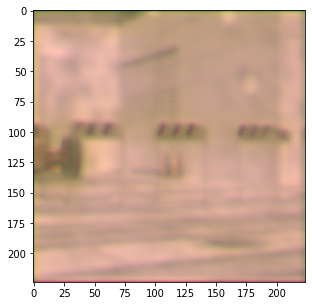

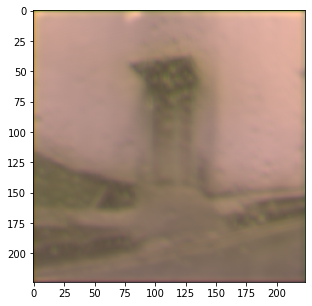

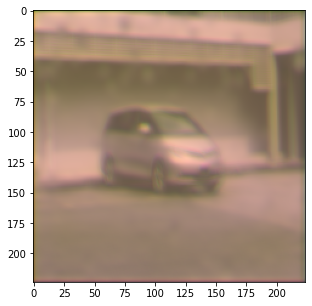

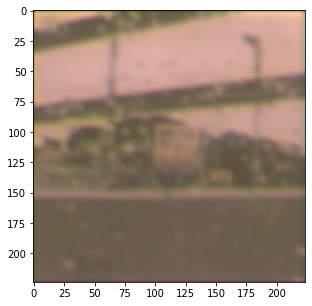

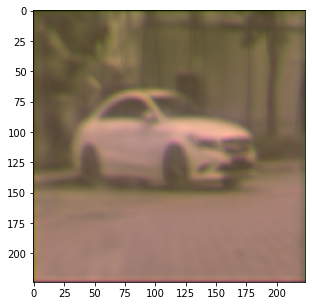

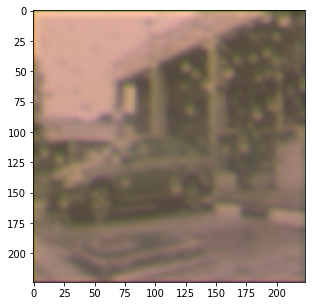

Epoch : 1 , In validation dataset, PSNR is 17.6375 and SSIM is 0.6704
save model !!!!!!!!!!
count: 1,loss_G: 1.5326 ,loss_D: 0.0140 ,loss_GANL 0.0432 ,loss_disc: 0.0134 ,loss_PL: 0.6574 ,loss_ML: 0.0814 ,loss_Att: 0.7506 ,loss_MAP: 0.0006
count: 20,loss_G: 0.9199 ,loss_D: 0.0153 ,loss_GANL 0.0460 ,loss_disc: 0.0131 ,loss_PL: 0.4157 ,loss_ML: 0.0635 ,loss_Att: 0.3947 ,loss_MAP: 0.0021
count: 40,loss_G: 0.8410 ,loss_D: 0.0115 ,loss_GANL 0.0470 ,loss_disc: 0.0111 ,loss_PL: 0.3581 ,loss_ML: 0.0705 ,loss_Att: 0.3654 ,loss_MAP: 0.0004
count: 60,loss_G: 0.9126 ,loss_D: 0.0105 ,loss_GANL 0.0471 ,loss_disc: 0.0101 ,loss_PL: 0.3828 ,loss_ML: 0.0653 ,loss_Att: 0.4174 ,loss_MAP: 0.0004
count: 80,loss_G: 0.9681 ,loss_D: 0.0112 ,loss_GANL 0.0469 ,loss_disc: 0.0104 ,loss_PL: 0.4137 ,loss_ML: 0.0555 ,loss_Att: 0.4520 ,loss_MAP: 0.0009
count: 100,loss_G: 0.9237 ,loss_D: 0.0113 ,loss_GANL 0.0470 ,loss_disc: 0.0107 ,loss_PL: 0.3905 ,loss_ML: 0.0504 ,loss_Att: 0.4358 ,loss_MAP: 0.0006
count: 120,loss_G: 1

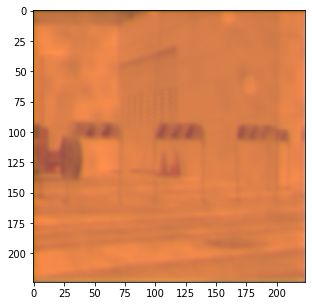

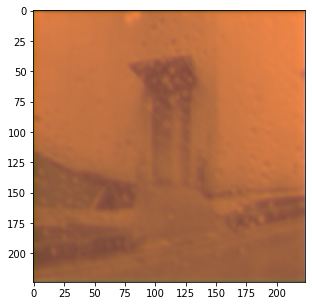

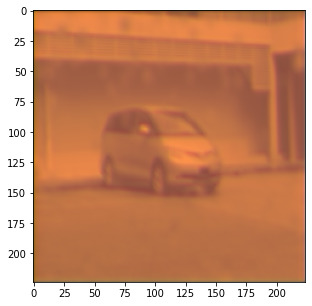

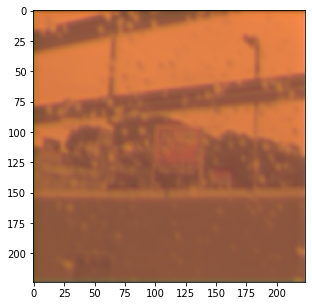

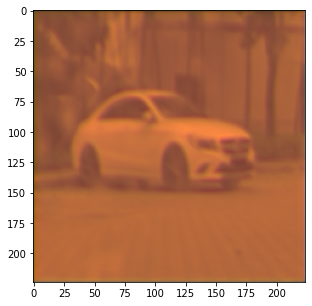

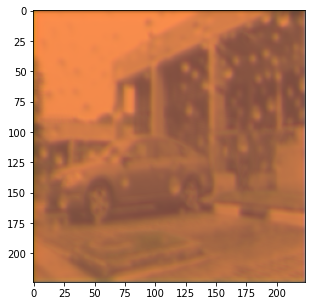

Epoch : 2 , In validation dataset, PSNR is 15.0797 and SSIM is 0.6393
count: 1,loss_G: 1.0455 ,loss_D: 0.2353 ,loss_GANL 0.0221 ,loss_disc: 0.1161 ,loss_PL: 0.4845 ,loss_ML: 0.1754 ,loss_Att: 0.3636 ,loss_MAP: 0.1192
count: 20,loss_G: 1.0086 ,loss_D: 0.2227 ,loss_GANL 0.0296 ,loss_disc: 0.1863 ,loss_PL: 0.3909 ,loss_ML: 0.1466 ,loss_Att: 0.4415 ,loss_MAP: 0.0364
count: 40,loss_G: 1.3870 ,loss_D: 35.8870 ,loss_GANL 0.0241 ,loss_disc: 35.6836 ,loss_PL: 0.6345 ,loss_ML: 0.3079 ,loss_Att: 0.4205 ,loss_MAP: 0.2033
count: 60,loss_G: 2.2048 ,loss_D: 0.2333 ,loss_GANL 0.0264 ,loss_disc: 0.2255 ,loss_PL: 1.0391 ,loss_ML: 0.6811 ,loss_Att: 0.4583 ,loss_MAP: 0.0078
count: 80,loss_G: 1.3649 ,loss_D: 0.0142 ,loss_GANL 0.0453 ,loss_disc: 0.0135 ,loss_PL: 0.5415 ,loss_ML: 0.4456 ,loss_Att: 0.3326 ,loss_MAP: 0.0008
count: 100,loss_G: 1.3766 ,loss_D: 0.0153 ,loss_GANL 0.0454 ,loss_disc: 0.0116 ,loss_PL: 0.5441 ,loss_ML: 0.3424 ,loss_Att: 0.4447 ,loss_MAP: 0.0036
count: 120,loss_G: 1.2669 ,loss_D: 0.011

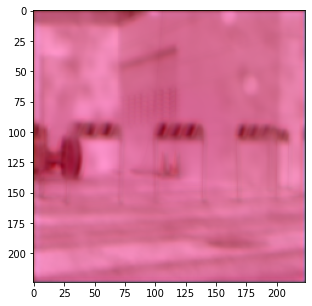

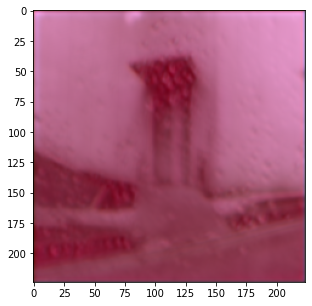

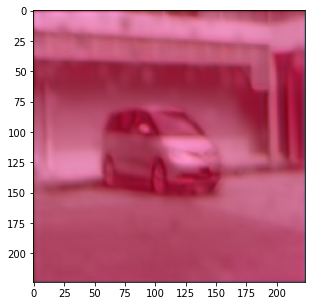

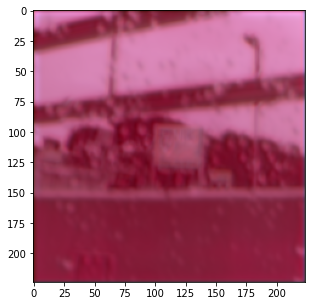

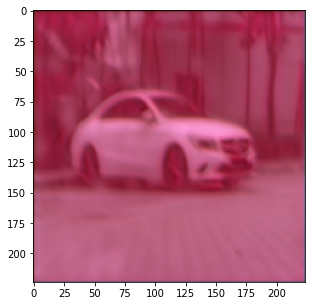

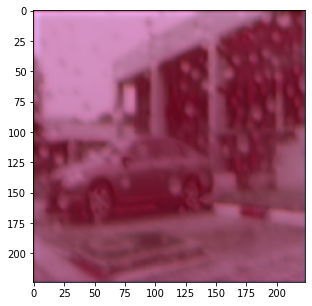

Epoch : 3 , In validation dataset, PSNR is 17.2541 and SSIM is 0.6976
count: 1,loss_G: 0.9936 ,loss_D: 100.0085 ,loss_GANL 0.0000 ,loss_disc: 100.0000 ,loss_PL: 0.6101 ,loss_ML: 0.1047 ,loss_Att: 0.2787 ,loss_MAP: 0.0085
count: 20,loss_G: 1.8870 ,loss_D: 31.5581 ,loss_GANL 0.0378 ,loss_disc: 31.5337 ,loss_PL: 0.9051 ,loss_ML: 0.3932 ,loss_Att: 0.5508 ,loss_MAP: 0.0244
count: 40,loss_G: 1.2473 ,loss_D: 0.4168 ,loss_GANL 0.0437 ,loss_disc: 0.4000 ,loss_PL: 0.5651 ,loss_ML: 0.1702 ,loss_Att: 0.4684 ,loss_MAP: 0.0168
count: 60,loss_G: 1.3997 ,loss_D: 0.0503 ,loss_GANL 0.0600 ,loss_disc: 0.0278 ,loss_PL: 0.6169 ,loss_ML: 0.2127 ,loss_Att: 0.5100 ,loss_MAP: 0.0225
count: 80,loss_G: 1.2569 ,loss_D: 0.0343 ,loss_GANL 0.0447 ,loss_disc: 0.0149 ,loss_PL: 0.5262 ,loss_ML: 0.1525 ,loss_Att: 0.5335 ,loss_MAP: 0.0194
count: 100,loss_G: 1.2715 ,loss_D: 0.0532 ,loss_GANL 0.0475 ,loss_disc: 0.0348 ,loss_PL: 0.5811 ,loss_ML: 0.1695 ,loss_Att: 0.4734 ,loss_MAP: 0.0185
count: 120,loss_G: 0.9685 ,loss_D: 0

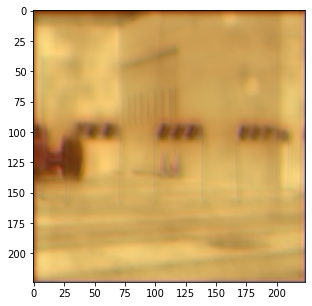

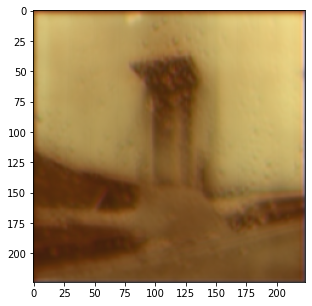

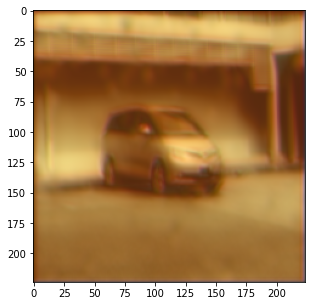

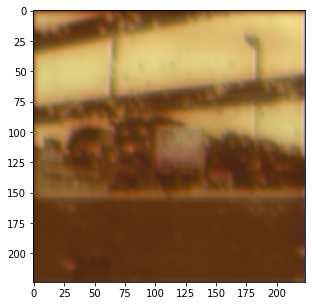

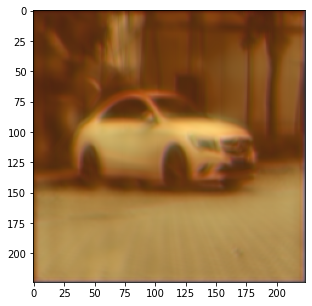

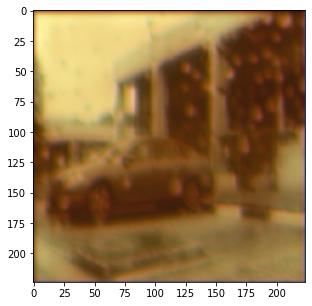

Epoch : 4 , In validation dataset, PSNR is 17.9544 and SSIM is 0.6703
count: 1,loss_G: 1.1810 ,loss_D: 1.4685 ,loss_GANL 0.0102 ,loss_disc: 1.4665 ,loss_PL: 0.5063 ,loss_ML: 0.0677 ,loss_Att: 0.5967 ,loss_MAP: 0.0020
count: 20,loss_G: 0.9117 ,loss_D: 1.4629 ,loss_GANL 0.0101 ,loss_disc: 1.4610 ,loss_PL: 0.4245 ,loss_ML: 0.0828 ,loss_Att: 0.3944 ,loss_MAP: 0.0019
count: 40,loss_G: 0.9319 ,loss_D: 1.4444 ,loss_GANL 0.0100 ,loss_disc: 1.4430 ,loss_PL: 0.4009 ,loss_ML: 0.0728 ,loss_Att: 0.4483 ,loss_MAP: 0.0013
count: 60,loss_G: 0.8853 ,loss_D: 1.3716 ,loss_GANL 0.0109 ,loss_disc: 1.3698 ,loss_PL: 0.3805 ,loss_ML: 0.0639 ,loss_Att: 0.4299 ,loss_MAP: 0.0018
count: 80,loss_G: 1.0040 ,loss_D: 1.2801 ,loss_GANL 0.0126 ,loss_disc: 1.2774 ,loss_PL: 0.4588 ,loss_ML: 0.0647 ,loss_Att: 0.4679 ,loss_MAP: 0.0027
count: 100,loss_G: 1.0251 ,loss_D: 1.1023 ,loss_GANL 0.0219 ,loss_disc: 1.0984 ,loss_PL: 0.4427 ,loss_ML: 0.0702 ,loss_Att: 0.4903 ,loss_MAP: 0.0039
count: 120,loss_G: 1.0366 ,loss_D: 0.9071 

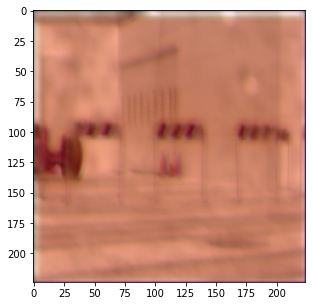

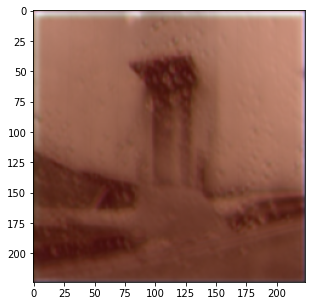

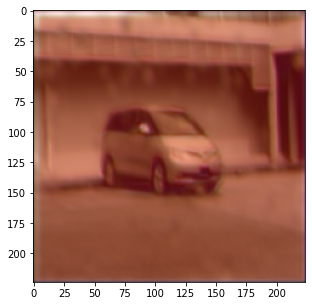

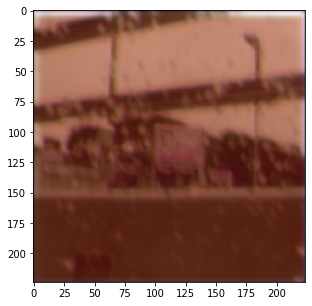

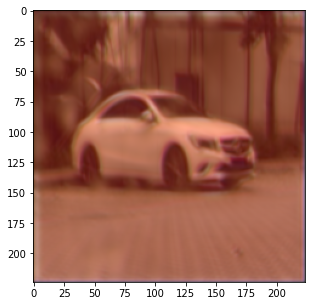

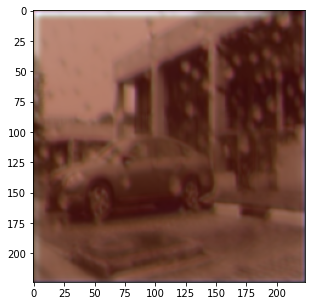

Epoch : 5 , In validation dataset, PSNR is 16.0845 and SSIM is 0.6798
count: 1,loss_G: 1.3339 ,loss_D: 0.2517 ,loss_GANL 0.0488 ,loss_disc: 0.2485 ,loss_PL: 0.4545 ,loss_ML: 0.0776 ,loss_Att: 0.7531 ,loss_MAP: 0.0033
count: 20,loss_G: 1.0692 ,loss_D: 0.1909 ,loss_GANL 0.0429 ,loss_disc: 0.1862 ,loss_PL: 0.4244 ,loss_ML: 0.1067 ,loss_Att: 0.4951 ,loss_MAP: 0.0047
count: 40,loss_G: 1.0850 ,loss_D: 0.0142 ,loss_GANL 0.0499 ,loss_disc: 0.0092 ,loss_PL: 0.4321 ,loss_ML: 0.1090 ,loss_Att: 0.4939 ,loss_MAP: 0.0050
count: 60,loss_G: 0.9650 ,loss_D: 0.0162 ,loss_GANL 0.0470 ,loss_disc: 0.0122 ,loss_PL: 0.4251 ,loss_ML: 0.0687 ,loss_Att: 0.4242 ,loss_MAP: 0.0040
count: 80,loss_G: 1.1086 ,loss_D: 0.0501 ,loss_GANL 0.0438 ,loss_disc: 0.0456 ,loss_PL: 0.4355 ,loss_ML: 0.2513 ,loss_Att: 0.3779 ,loss_MAP: 0.0045
count: 100,loss_G: 1.2183 ,loss_D: 0.0138 ,loss_GANL 0.0463 ,loss_disc: 0.0101 ,loss_PL: 0.4894 ,loss_ML: 0.1911 ,loss_Att: 0.4915 ,loss_MAP: 0.0037
count: 120,loss_G: 1.2153 ,loss_D: 0.0133 

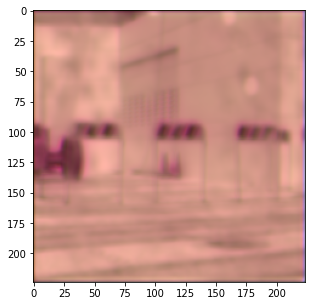

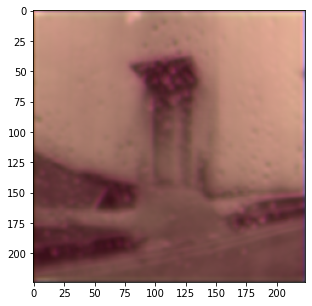

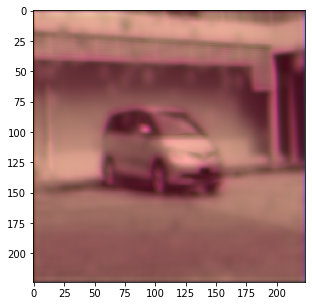

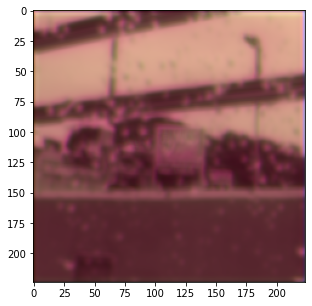

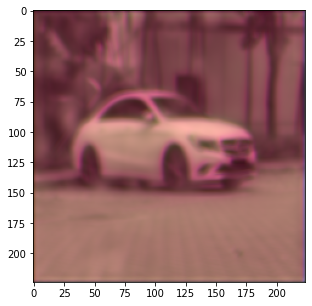

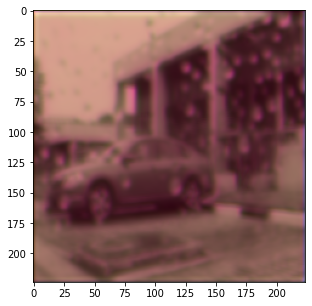

Epoch : 6 , In validation dataset, PSNR is 18.3638 and SSIM is 0.7004
save model !!!!!!!!!!
count: 1,loss_G: 1.3366 ,loss_D: 0.0099 ,loss_GANL 0.0479 ,loss_disc: 0.0083 ,loss_PL: 0.5861 ,loss_ML: 0.0982 ,loss_Att: 0.6044 ,loss_MAP: 0.0015
count: 20,loss_G: 1.4981 ,loss_D: 0.0171 ,loss_GANL 0.0549 ,loss_disc: 0.0145 ,loss_PL: 0.4807 ,loss_ML: 0.5397 ,loss_Att: 0.4228 ,loss_MAP: 0.0025
count: 40,loss_G: 1.0779 ,loss_D: 0.0144 ,loss_GANL 0.0455 ,loss_disc: 0.0114 ,loss_PL: 0.4523 ,loss_ML: 0.0853 ,loss_Att: 0.4949 ,loss_MAP: 0.0030
count: 60,loss_G: 1.0836 ,loss_D: 85.2423 ,loss_GANL 0.0054 ,loss_disc: 85.2233 ,loss_PL: 0.4402 ,loss_ML: 0.0825 ,loss_Att: 0.5556 ,loss_MAP: 0.0190
count: 80,loss_G: 1.5059 ,loss_D: 46.0170 ,loss_GANL 0.0245 ,loss_disc: 46.0036 ,loss_PL: 0.6389 ,loss_ML: 0.2867 ,loss_Att: 0.5558 ,loss_MAP: 0.0134
count: 100,loss_G: 1.2807 ,loss_D: 0.0284 ,loss_GANL 0.0517 ,loss_disc: 0.0140 ,loss_PL: 0.5601 ,loss_ML: 0.1609 ,loss_Att: 0.5080 ,loss_MAP: 0.0144
count: 120,loss_

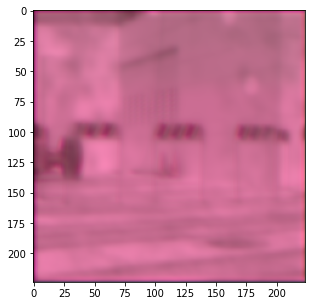

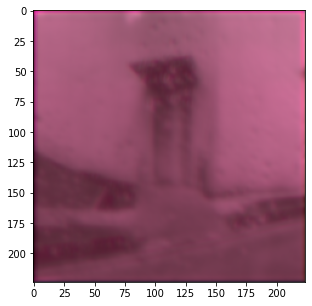

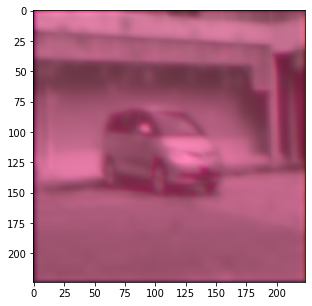

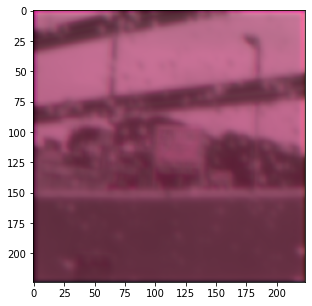

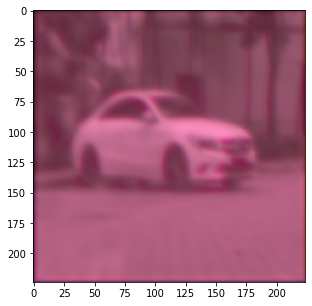

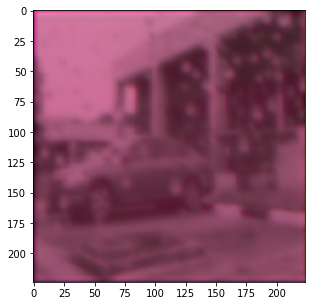

Epoch : 7 , In validation dataset, PSNR is 16.2908 and SSIM is 0.6680
count: 1,loss_G: 1.2734 ,loss_D: 0.2468 ,loss_GANL 0.0522 ,loss_disc: 0.2446 ,loss_PL: 0.5897 ,loss_ML: 0.0960 ,loss_Att: 0.5356 ,loss_MAP: 0.0022
count: 20,loss_G: 1.0026 ,loss_D: 0.2386 ,loss_GANL 0.0462 ,loss_disc: 0.2364 ,loss_PL: 0.4325 ,loss_ML: 0.0656 ,loss_Att: 0.4584 ,loss_MAP: 0.0022
count: 40,loss_G: 0.9758 ,loss_D: 0.2322 ,loss_GANL 0.0484 ,loss_disc: 0.2302 ,loss_PL: 0.3813 ,loss_ML: 0.0640 ,loss_Att: 0.4821 ,loss_MAP: 0.0020
count: 60,loss_G: 1.1524 ,loss_D: 0.2123 ,loss_GANL 0.0465 ,loss_disc: 0.2108 ,loss_PL: 0.4433 ,loss_ML: 0.0740 ,loss_Att: 0.5886 ,loss_MAP: 0.0015
count: 80,loss_G: 1.8520 ,loss_D: 1.0263 ,loss_GANL 0.0839 ,loss_disc: 1.0114 ,loss_PL: 0.8963 ,loss_ML: 0.4411 ,loss_Att: 0.4306 ,loss_MAP: 0.0149
count: 100,loss_G: 1.1098 ,loss_D: 0.2084 ,loss_GANL 0.0692 ,loss_disc: 0.2050 ,loss_PL: 0.4675 ,loss_ML: 0.1764 ,loss_Att: 0.3967 ,loss_MAP: 0.0034
count: 120,loss_G: 1.0166 ,loss_D: 0.2032 

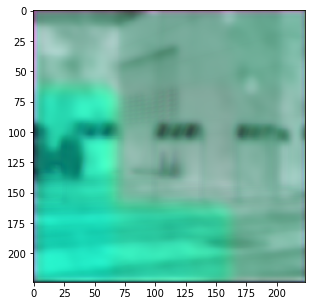

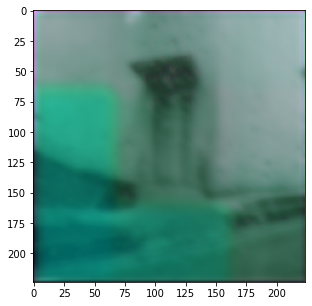

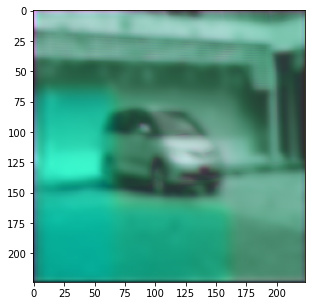

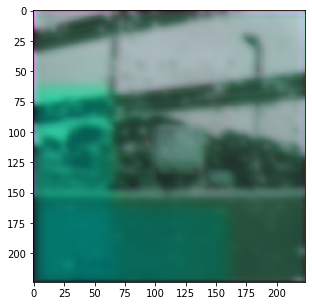

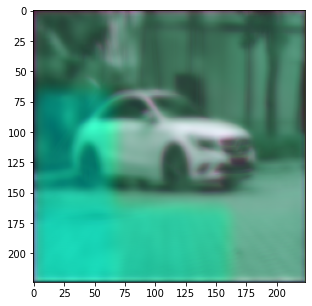

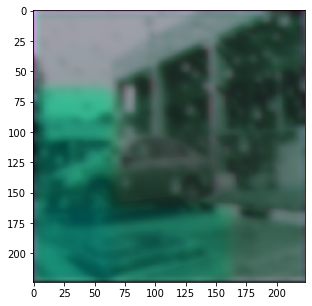

Epoch : 8 , In validation dataset, PSNR is 17.8718 and SSIM is 0.6821
count: 1,loss_G: 1.2383 ,loss_D: 0.0449 ,loss_GANL 0.1085 ,loss_disc: 0.0380 ,loss_PL: 0.6175 ,loss_ML: 0.0777 ,loss_Att: 0.4346 ,loss_MAP: 0.0069
count: 20,loss_G: 1.0618 ,loss_D: 0.0569 ,loss_GANL 0.0623 ,loss_disc: 0.0510 ,loss_PL: 0.4333 ,loss_ML: 0.0777 ,loss_Att: 0.4885 ,loss_MAP: 0.0059
count: 40,loss_G: 0.9610 ,loss_D: 0.0532 ,loss_GANL 0.0490 ,loss_disc: 0.0476 ,loss_PL: 0.4052 ,loss_ML: 0.0800 ,loss_Att: 0.4268 ,loss_MAP: 0.0057
count: 60,loss_G: 1.0520 ,loss_D: 0.0539 ,loss_GANL 0.0520 ,loss_disc: 0.0486 ,loss_PL: 0.4378 ,loss_ML: 0.0721 ,loss_Att: 0.4901 ,loss_MAP: 0.0053
count: 80,loss_G: 0.9141 ,loss_D: 0.0564 ,loss_GANL 0.0727 ,loss_disc: 0.0504 ,loss_PL: 0.3695 ,loss_ML: 0.0828 ,loss_Att: 0.3891 ,loss_MAP: 0.0059
count: 100,loss_G: 1.0746 ,loss_D: 0.0494 ,loss_GANL 0.0462 ,loss_disc: 0.0443 ,loss_PL: 0.4700 ,loss_ML: 0.0780 ,loss_Att: 0.4805 ,loss_MAP: 0.0052
count: 120,loss_G: 0.9958 ,loss_D: 0.0520 

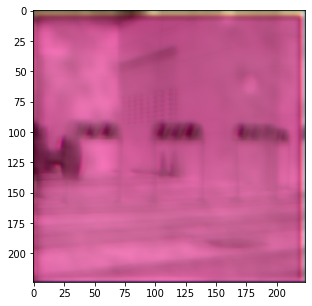

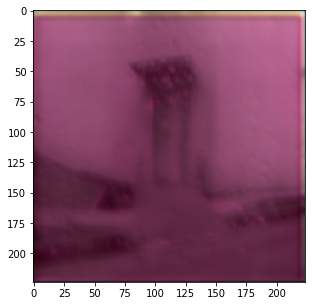

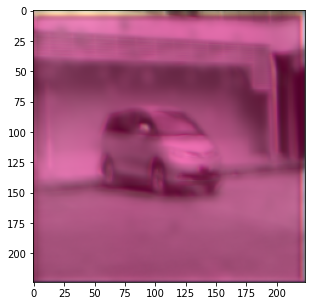

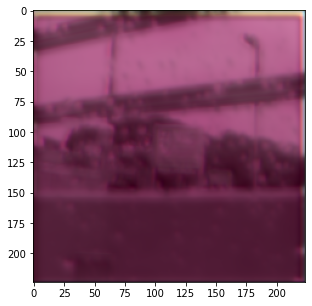

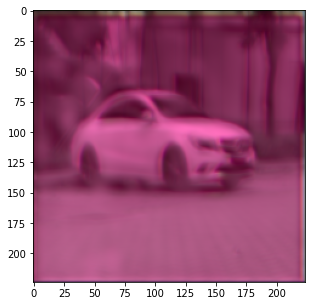

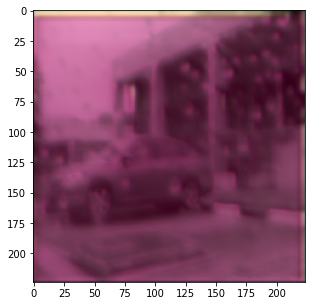

Epoch : 9 , In validation dataset, PSNR is 15.9151 and SSIM is 0.6647
count: 1,loss_G: 0.9132 ,loss_D: 0.0306 ,loss_GANL 0.0466 ,loss_disc: 0.0298 ,loss_PL: 0.4767 ,loss_ML: 0.0747 ,loss_Att: 0.3152 ,loss_MAP: 0.0008
count: 20,loss_G: 1.1165 ,loss_D: 0.0323 ,loss_GANL 0.0470 ,loss_disc: 0.0317 ,loss_PL: 0.4890 ,loss_ML: 0.0764 ,loss_Att: 0.5041 ,loss_MAP: 0.0006
count: 40,loss_G: 1.0373 ,loss_D: 0.0305 ,loss_GANL 0.0475 ,loss_disc: 0.0300 ,loss_PL: 0.4513 ,loss_ML: 0.0702 ,loss_Att: 0.4683 ,loss_MAP: 0.0005
count: 60,loss_G: 0.9936 ,loss_D: 0.0299 ,loss_GANL 0.0477 ,loss_disc: 0.0295 ,loss_PL: 0.4392 ,loss_ML: 0.0666 ,loss_Att: 0.4400 ,loss_MAP: 0.0004
count: 80,loss_G: 1.1031 ,loss_D: 0.0283 ,loss_GANL 0.0499 ,loss_disc: 0.0278 ,loss_PL: 0.4850 ,loss_ML: 0.0655 ,loss_Att: 0.5027 ,loss_MAP: 0.0005
count: 100,loss_G: 0.9183 ,loss_D: 0.0296 ,loss_GANL 0.0455 ,loss_disc: 0.0292 ,loss_PL: 0.4139 ,loss_ML: 0.0554 ,loss_Att: 0.4035 ,loss_MAP: 0.0003
count: 120,loss_G: 0.9728 ,loss_D: 0.0279 

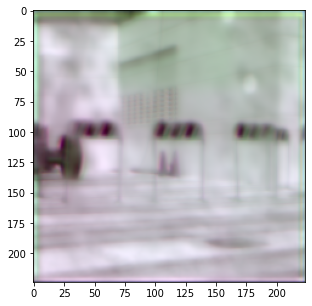

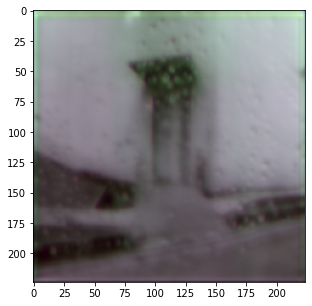

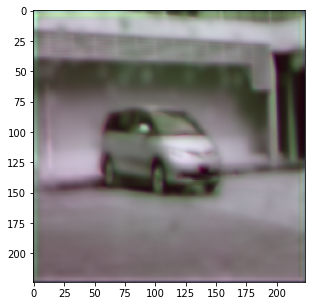

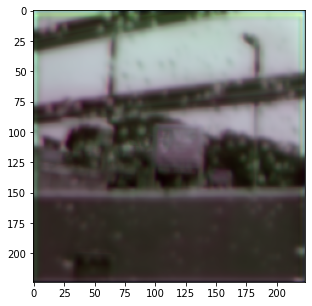

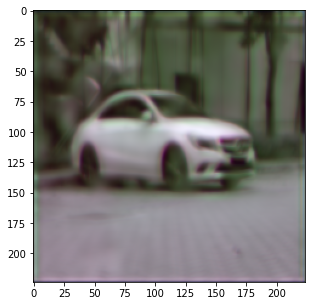

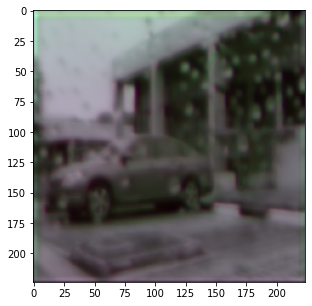

Epoch : 10 , In validation dataset, PSNR is 19.5551 and SSIM is 0.7425
save model !!!!!!!!!!
count: 1,loss_G: 0.7637 ,loss_D: 1.3946 ,loss_GANL 0.0061 ,loss_disc: 1.3940 ,loss_PL: 0.3327 ,loss_ML: 0.0319 ,loss_Att: 0.3930 ,loss_MAP: 0.0007
count: 20,loss_G: 0.8306 ,loss_D: 1.3909 ,loss_GANL 0.0063 ,loss_disc: 1.3902 ,loss_PL: 0.4054 ,loss_ML: 0.0324 ,loss_Att: 0.3865 ,loss_MAP: 0.0006
count: 40,loss_G: 1.0192 ,loss_D: 1.3880 ,loss_GANL 0.0067 ,loss_disc: 1.3871 ,loss_PL: 0.3770 ,loss_ML: 0.0411 ,loss_Att: 0.5944 ,loss_MAP: 0.0009
count: 60,loss_G: 0.8041 ,loss_D: 1.3874 ,loss_GANL 0.0068 ,loss_disc: 1.3865 ,loss_PL: 0.3489 ,loss_ML: 0.0359 ,loss_Att: 0.4125 ,loss_MAP: 0.0009
count: 80,loss_G: 0.8622 ,loss_D: 1.3873 ,loss_GANL 0.0068 ,loss_disc: 1.3864 ,loss_PL: 0.3744 ,loss_ML: 0.0337 ,loss_Att: 0.4472 ,loss_MAP: 0.0009
count: 100,loss_G: 0.9019 ,loss_D: 1.3871 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.4072 ,loss_ML: 0.0380 ,loss_Att: 0.4499 ,loss_MAP: 0.0008
count: 120,loss_G: 

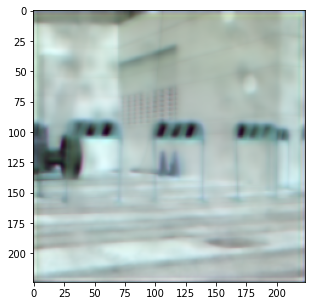

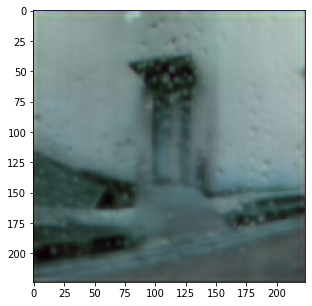

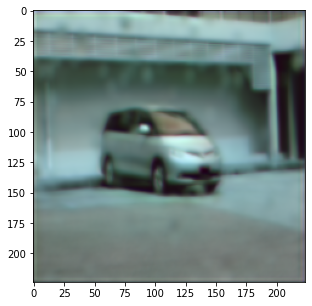

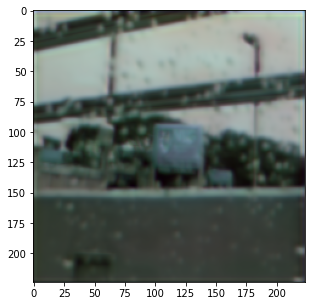

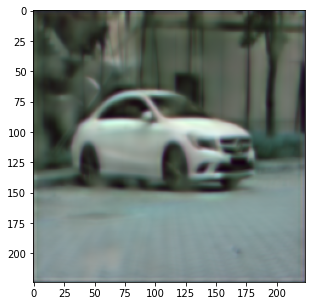

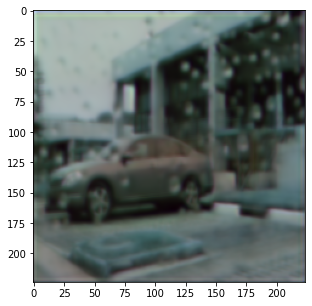

Epoch : 11 , In validation dataset, PSNR is 20.7078 and SSIM is 0.7858
save model !!!!!!!!!!
count: 1,loss_G: 0.3462 ,loss_D: 1.3873 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1095 ,loss_ML: 0.0175 ,loss_Att: 0.2123 ,loss_MAP: 0.0010
count: 20,loss_G: 0.8057 ,loss_D: 1.3872 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3198 ,loss_ML: 0.0331 ,loss_Att: 0.4459 ,loss_MAP: 0.0009
count: 40,loss_G: 0.8545 ,loss_D: 1.3872 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3199 ,loss_ML: 0.0324 ,loss_Att: 0.4953 ,loss_MAP: 0.0009
count: 60,loss_G: 0.7988 ,loss_D: 1.3872 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3272 ,loss_ML: 0.0261 ,loss_Att: 0.4385 ,loss_MAP: 0.0009
count: 80,loss_G: 0.7169 ,loss_D: 1.3870 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3269 ,loss_ML: 0.0275 ,loss_Att: 0.3557 ,loss_MAP: 0.0007
count: 100,loss_G: 0.8370 ,loss_D: 1.3870 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2990 ,loss_ML: 0.0385 ,loss_Att: 0.4927 ,loss_MAP: 0.0007
count: 120,loss_G: 

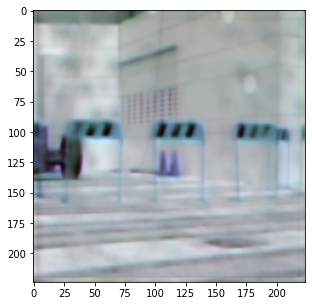

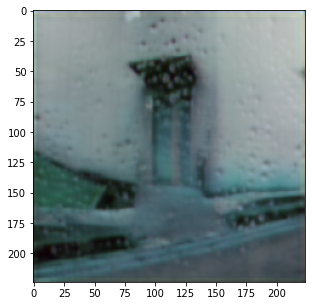

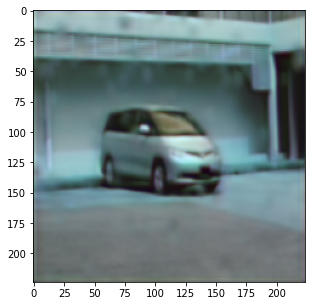

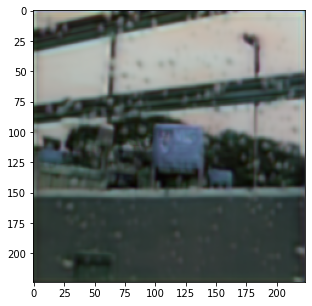

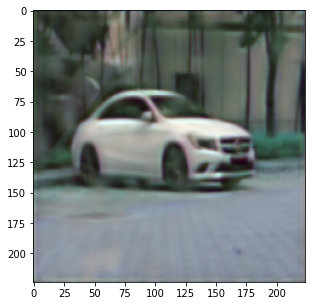

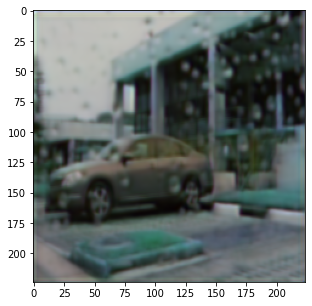

Epoch : 12 , In validation dataset, PSNR is 21.4906 and SSIM is 0.8137
save model !!!!!!!!!!
count: 1,loss_G: 0.8340 ,loss_D: 1.3871 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3853 ,loss_ML: 0.0236 ,loss_Att: 0.4183 ,loss_MAP: 0.0008
count: 20,loss_G: 0.7965 ,loss_D: 1.3872 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3172 ,loss_ML: 0.0283 ,loss_Att: 0.4441 ,loss_MAP: 0.0009
count: 40,loss_G: 0.7764 ,loss_D: 1.3872 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2861 ,loss_ML: 0.0285 ,loss_Att: 0.4549 ,loss_MAP: 0.0009
count: 60,loss_G: 0.7718 ,loss_D: 1.3875 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3107 ,loss_ML: 0.0237 ,loss_Att: 0.4305 ,loss_MAP: 0.0011
count: 80,loss_G: 0.8959 ,loss_D: 1.3873 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3247 ,loss_ML: 0.0376 ,loss_Att: 0.5268 ,loss_MAP: 0.0010
count: 100,loss_G: 0.7798 ,loss_D: 1.3877 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3306 ,loss_ML: 0.0276 ,loss_Att: 0.4148 ,loss_MAP: 0.0014
count: 120,loss_G: 

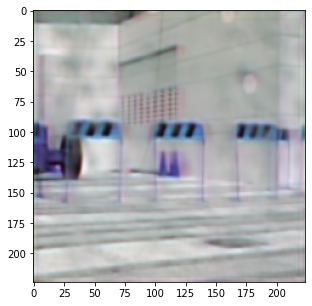

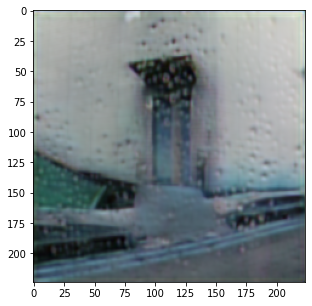

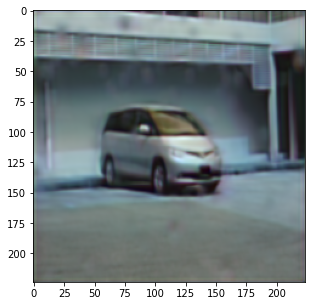

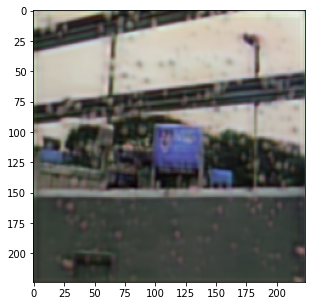

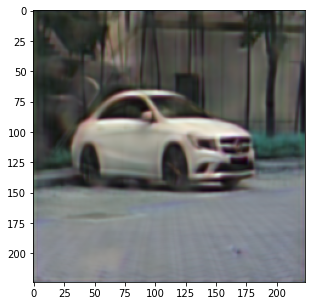

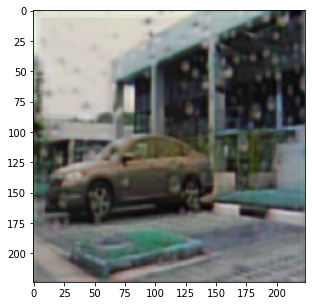

Epoch : 13 , In validation dataset, PSNR is 21.8728 and SSIM is 0.8285
save model !!!!!!!!!!
count: 1,loss_G: 0.6440 ,loss_D: 1.3882 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2879 ,loss_ML: 0.0214 ,loss_Att: 0.3278 ,loss_MAP: 0.0019
count: 20,loss_G: 0.5787 ,loss_D: 1.3874 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2355 ,loss_ML: 0.0158 ,loss_Att: 0.3205 ,loss_MAP: 0.0011
count: 40,loss_G: 0.7872 ,loss_D: 1.3881 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2988 ,loss_ML: 0.0267 ,loss_Att: 0.4548 ,loss_MAP: 0.0018
count: 60,loss_G: 0.6101 ,loss_D: 1.3877 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2522 ,loss_ML: 0.0190 ,loss_Att: 0.3320 ,loss_MAP: 0.0013
count: 80,loss_G: 0.8138 ,loss_D: 1.3887 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3129 ,loss_ML: 0.0283 ,loss_Att: 0.4658 ,loss_MAP: 0.0024
count: 100,loss_G: 0.7318 ,loss_D: 1.3884 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2852 ,loss_ML: 0.0378 ,loss_Att: 0.4018 ,loss_MAP: 0.0020
count: 120,loss_G: 

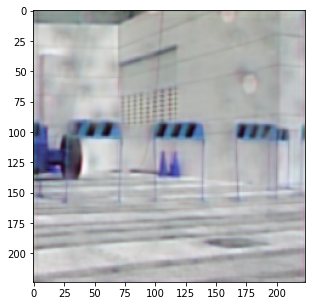

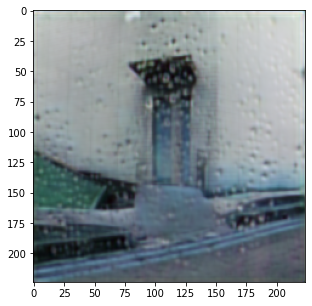

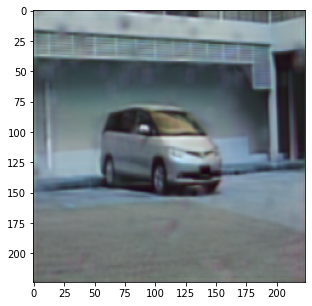

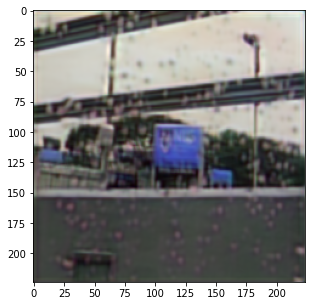

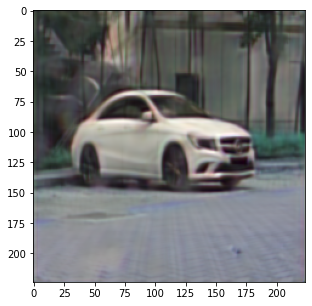

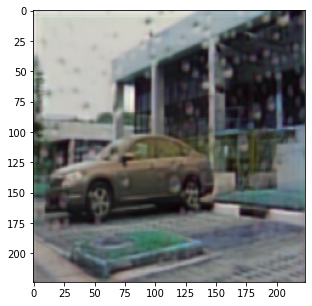

Epoch : 14 , In validation dataset, PSNR is 22.5595 and SSIM is 0.8456
save model !!!!!!!!!!
count: 1,loss_G: 0.5485 ,loss_D: 1.3886 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2726 ,loss_ML: 0.0181 ,loss_Att: 0.2510 ,loss_MAP: 0.0023
count: 20,loss_G: 0.6654 ,loss_D: 1.3884 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2781 ,loss_ML: 0.0228 ,loss_Att: 0.3575 ,loss_MAP: 0.0021
count: 40,loss_G: 0.6695 ,loss_D: 1.3888 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2895 ,loss_ML: 0.0191 ,loss_Att: 0.3540 ,loss_MAP: 0.0025
count: 60,loss_G: 0.6017 ,loss_D: 1.3878 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2495 ,loss_ML: 0.0223 ,loss_Att: 0.3230 ,loss_MAP: 0.0015
count: 80,loss_G: 0.5939 ,loss_D: 1.3879 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2506 ,loss_ML: 0.0170 ,loss_Att: 0.3194 ,loss_MAP: 0.0016
count: 100,loss_G: 0.6608 ,loss_D: 1.3887 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2343 ,loss_ML: 0.0263 ,loss_Att: 0.3933 ,loss_MAP: 0.0024
count: 120,loss_G: 

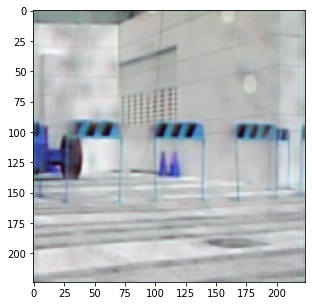

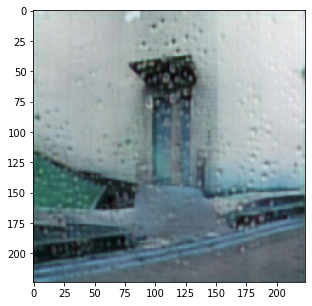

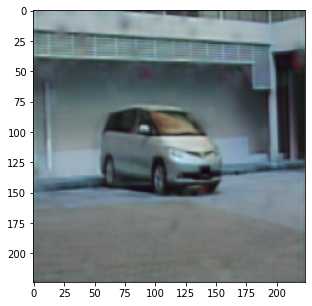

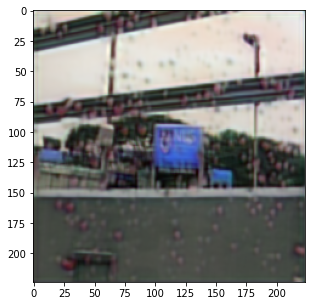

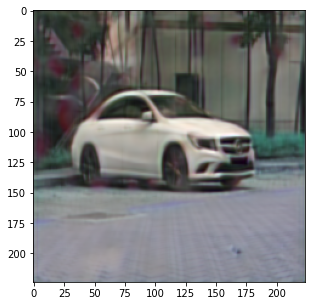

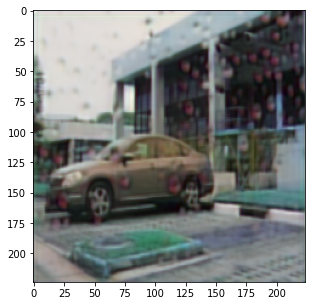

Epoch : 15 , In validation dataset, PSNR is 22.7417 and SSIM is 0.8574
save model !!!!!!!!!!
count: 1,loss_G: 0.3274 ,loss_D: 1.3880 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1603 ,loss_ML: 0.0123 ,loss_Att: 0.1479 ,loss_MAP: 0.0017
count: 20,loss_G: 0.6271 ,loss_D: 1.3882 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2413 ,loss_ML: 0.0257 ,loss_Att: 0.3532 ,loss_MAP: 0.0019
count: 40,loss_G: 0.6672 ,loss_D: 1.3894 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2727 ,loss_ML: 0.0264 ,loss_Att: 0.3612 ,loss_MAP: 0.0030
count: 60,loss_G: 0.6579 ,loss_D: 1.3885 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2763 ,loss_ML: 0.0229 ,loss_Att: 0.3518 ,loss_MAP: 0.0022
count: 80,loss_G: 0.6464 ,loss_D: 1.3883 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2646 ,loss_ML: 0.0231 ,loss_Att: 0.3518 ,loss_MAP: 0.0020
count: 100,loss_G: 0.6146 ,loss_D: 1.3888 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2462 ,loss_ML: 0.0237 ,loss_Att: 0.3378 ,loss_MAP: 0.0025
count: 120,loss_G: 

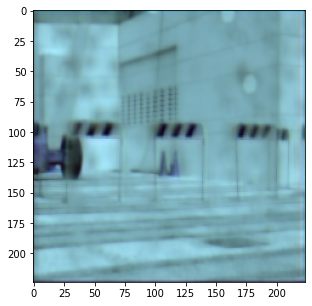

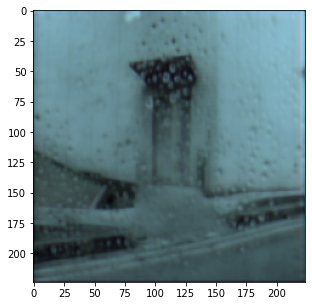

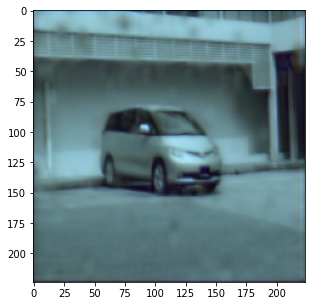

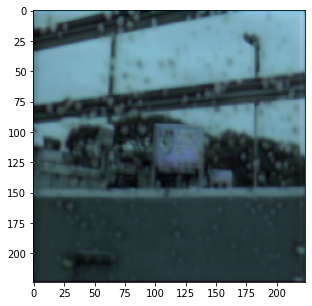

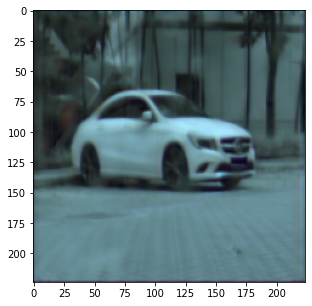

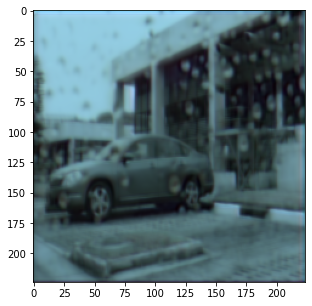

Epoch : 16 , In validation dataset, PSNR is 21.0971 and SSIM is 0.8146
count: 1,loss_G: 0.3606 ,loss_D: 1.3870 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1897 ,loss_ML: 0.0219 ,loss_Att: 0.1421 ,loss_MAP: 0.0007
count: 20,loss_G: 0.6747 ,loss_D: 1.3895 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2946 ,loss_ML: 0.0301 ,loss_Att: 0.3431 ,loss_MAP: 0.0032
count: 40,loss_G: 0.7857 ,loss_D: 1.3896 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.3135 ,loss_ML: 0.0312 ,loss_Att: 0.4341 ,loss_MAP: 0.0033
count: 60,loss_G: 0.6123 ,loss_D: 1.3888 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2847 ,loss_ML: 0.0236 ,loss_Att: 0.2971 ,loss_MAP: 0.0025
count: 80,loss_G: 0.6899 ,loss_D: 1.3900 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2919 ,loss_ML: 0.0273 ,loss_Att: 0.3638 ,loss_MAP: 0.0036
count: 100,loss_G: 0.5565 ,loss_D: 1.3893 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2389 ,loss_ML: 0.0206 ,loss_Att: 0.2900 ,loss_MAP: 0.0030
count: 120,loss_G: 0.6522 ,loss_D: 1.3899

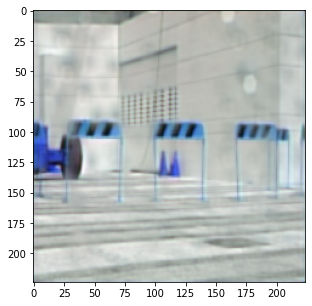

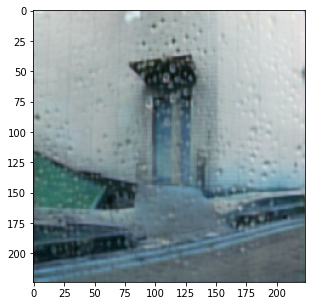

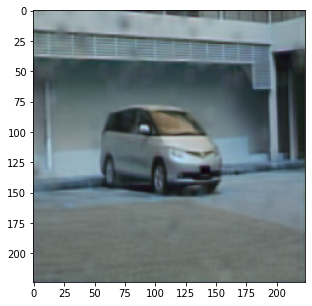

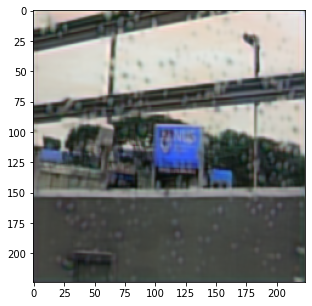

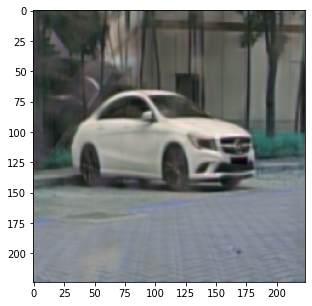

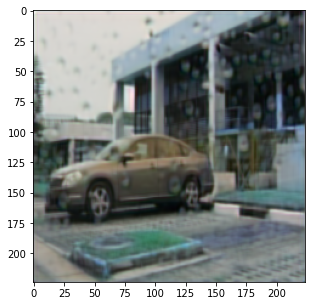

Epoch : 17 , In validation dataset, PSNR is 22.9713 and SSIM is 0.8665
save model !!!!!!!!!!
count: 1,loss_G: 0.8038 ,loss_D: 1.3872 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1568 ,loss_ML: 0.0147 ,loss_Att: 0.6255 ,loss_MAP: 0.0008
count: 20,loss_G: 0.5950 ,loss_D: 1.3890 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2485 ,loss_ML: 0.0166 ,loss_Att: 0.3231 ,loss_MAP: 0.0027
count: 40,loss_G: 0.5166 ,loss_D: 1.3890 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2122 ,loss_ML: 0.0166 ,loss_Att: 0.2809 ,loss_MAP: 0.0027
count: 60,loss_G: 0.5114 ,loss_D: 1.3891 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2352 ,loss_ML: 0.0148 ,loss_Att: 0.2545 ,loss_MAP: 0.0028
count: 80,loss_G: 0.4389 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1934 ,loss_ML: 0.0142 ,loss_Att: 0.2244 ,loss_MAP: 0.0026
count: 100,loss_G: 0.5797 ,loss_D: 1.3896 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2490 ,loss_ML: 0.0188 ,loss_Att: 0.3051 ,loss_MAP: 0.0033
count: 120,loss_G: 

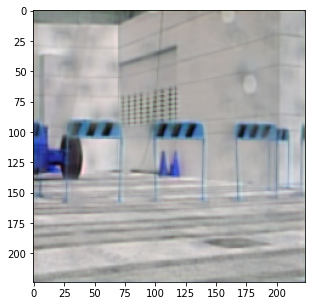

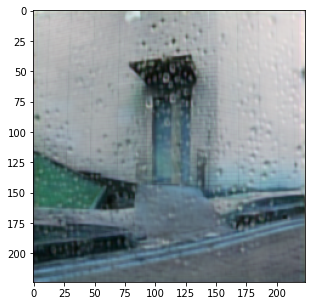

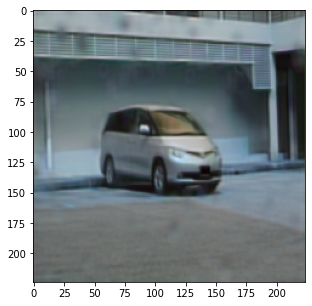

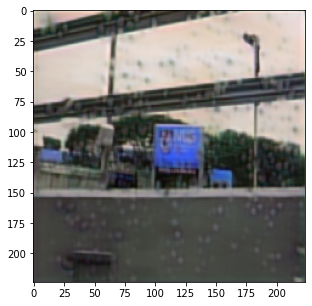

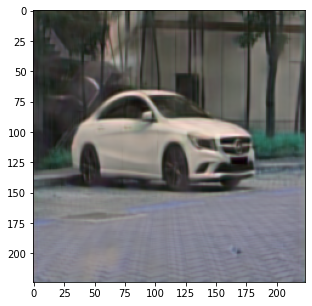

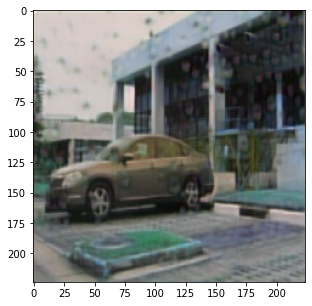

Epoch : 18 , In validation dataset, PSNR is 22.7317 and SSIM is 0.8704
count: 1,loss_G: 1.2844 ,loss_D: 1.3919 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.6008 ,loss_ML: 0.0437 ,loss_Att: 0.6331 ,loss_MAP: 0.0056
count: 20,loss_G: 0.5065 ,loss_D: 1.3891 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2030 ,loss_ML: 0.0167 ,loss_Att: 0.2800 ,loss_MAP: 0.0027
count: 40,loss_G: 0.5341 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2054 ,loss_ML: 0.0172 ,loss_Att: 0.3047 ,loss_MAP: 0.0026
count: 60,loss_G: 0.5207 ,loss_D: 1.3892 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2134 ,loss_ML: 0.0151 ,loss_Att: 0.2853 ,loss_MAP: 0.0029
count: 80,loss_G: 0.4596 ,loss_D: 1.3896 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1792 ,loss_ML: 0.0172 ,loss_Att: 0.2563 ,loss_MAP: 0.0033
count: 100,loss_G: 0.5450 ,loss_D: 1.3894 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2138 ,loss_ML: 0.0165 ,loss_Att: 0.3078 ,loss_MAP: 0.0031
count: 120,loss_G: 0.5326 ,loss_D: 1.3892

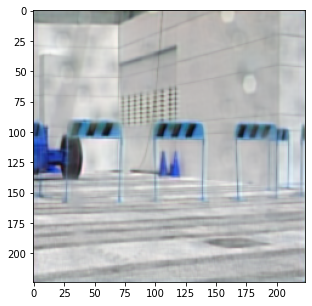

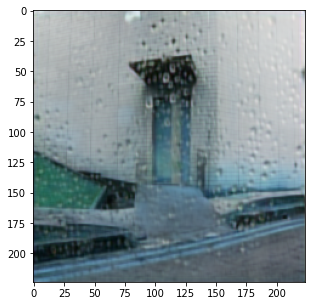

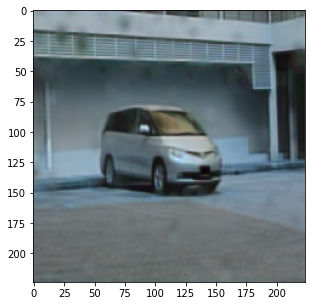

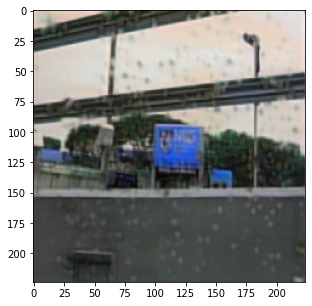

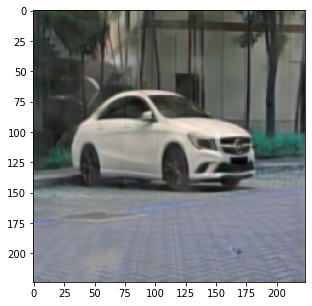

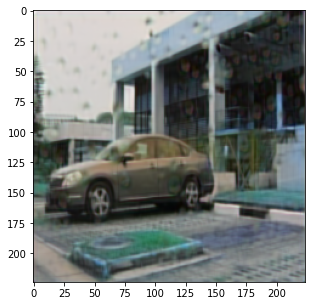

Epoch : 19 , In validation dataset, PSNR is 23.4997 and SSIM is 0.8818
save model !!!!!!!!!!
count: 1,loss_G: 0.5134 ,loss_D: 1.3915 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1715 ,loss_ML: 0.0133 ,loss_Att: 0.3217 ,loss_MAP: 0.0051
count: 20,loss_G: 0.5372 ,loss_D: 1.3895 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2006 ,loss_ML: 0.0184 ,loss_Att: 0.3113 ,loss_MAP: 0.0032
count: 40,loss_G: 0.5495 ,loss_D: 1.3892 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2249 ,loss_ML: 0.0172 ,loss_Att: 0.3005 ,loss_MAP: 0.0028
count: 60,loss_G: 0.5636 ,loss_D: 1.3892 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2125 ,loss_ML: 0.0186 ,loss_Att: 0.3255 ,loss_MAP: 0.0028
count: 80,loss_G: 0.5180 ,loss_D: 1.3890 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1873 ,loss_ML: 0.0153 ,loss_Att: 0.3085 ,loss_MAP: 0.0027
count: 100,loss_G: 0.5612 ,loss_D: 1.3894 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2132 ,loss_ML: 0.0156 ,loss_Att: 0.3256 ,loss_MAP: 0.0030
count: 120,loss_G: 

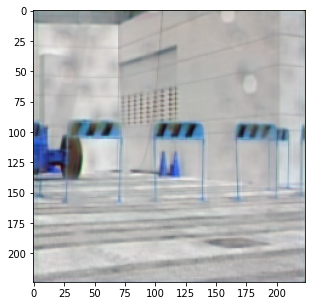

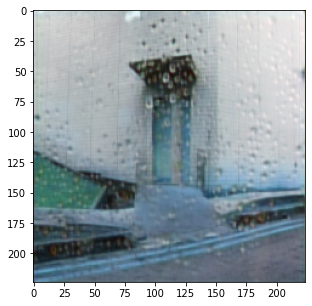

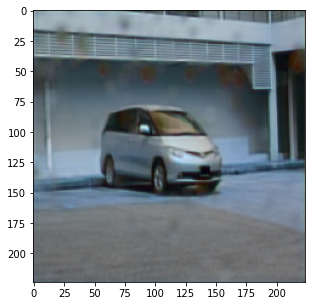

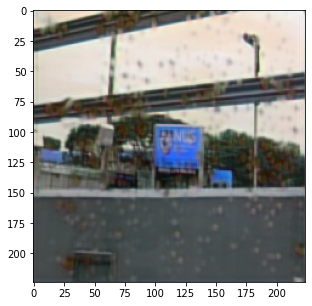

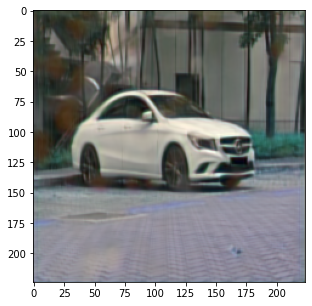

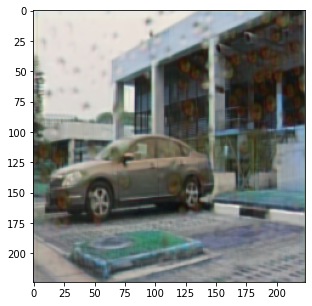

Epoch : 20 , In validation dataset, PSNR is 23.5895 and SSIM is 0.8826
save model !!!!!!!!!!
count: 1,loss_G: 0.6613 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2554 ,loss_ML: 0.0179 ,loss_Att: 0.3812 ,loss_MAP: 0.0025
count: 20,loss_G: 0.5645 ,loss_D: 1.3885 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1944 ,loss_ML: 0.0187 ,loss_Att: 0.3445 ,loss_MAP: 0.0022
count: 40,loss_G: 0.5641 ,loss_D: 1.3883 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2166 ,loss_ML: 0.0206 ,loss_Att: 0.3201 ,loss_MAP: 0.0020
count: 60,loss_G: 0.5374 ,loss_D: 1.3885 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1964 ,loss_ML: 0.0186 ,loss_Att: 0.3155 ,loss_MAP: 0.0022
count: 80,loss_G: 0.4944 ,loss_D: 1.3882 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1858 ,loss_ML: 0.0171 ,loss_Att: 0.2846 ,loss_MAP: 0.0019
count: 100,loss_G: 0.4511 ,loss_D: 1.3881 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1759 ,loss_ML: 0.0177 ,loss_Att: 0.2507 ,loss_MAP: 0.0018
count: 120,loss_G: 

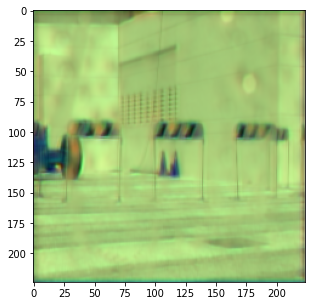

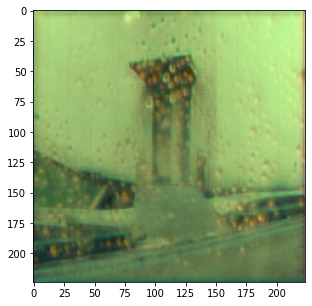

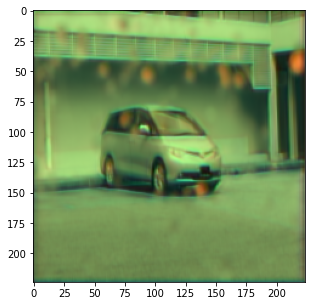

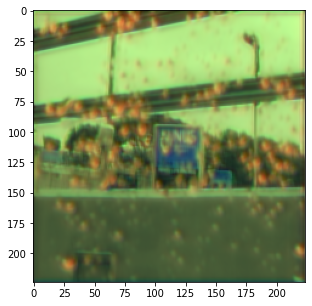

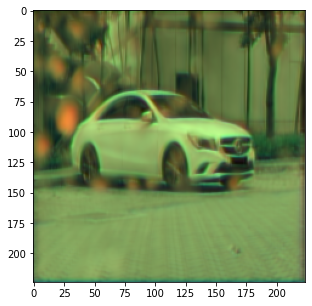

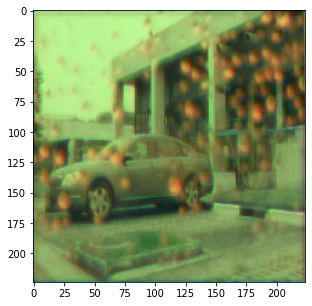

Epoch : 21 , In validation dataset, PSNR is 20.0500 and SSIM is 0.7839
count: 1,loss_G: 0.2578 ,loss_D: 1.3881 ,loss_GANL 0.0068 ,loss_disc: 1.3865 ,loss_PL: 0.1092 ,loss_ML: 0.0475 ,loss_Att: 0.0944 ,loss_MAP: 0.0016
count: 20,loss_G: 0.7378 ,loss_D: 1.3897 ,loss_GANL 0.0068 ,loss_disc: 1.3864 ,loss_PL: 0.3505 ,loss_ML: 0.0576 ,loss_Att: 0.3229 ,loss_MAP: 0.0033
count: 40,loss_G: 0.6494 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2853 ,loss_ML: 0.0302 ,loss_Att: 0.3271 ,loss_MAP: 0.0025
count: 60,loss_G: 0.5368 ,loss_D: 1.3893 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2668 ,loss_ML: 0.0199 ,loss_Att: 0.2432 ,loss_MAP: 0.0030
count: 80,loss_G: 0.4783 ,loss_D: 1.3886 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2218 ,loss_ML: 0.0170 ,loss_Att: 0.2325 ,loss_MAP: 0.0023
count: 100,loss_G: 0.4800 ,loss_D: 1.3894 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2209 ,loss_ML: 0.0174 ,loss_Att: 0.2348 ,loss_MAP: 0.0031
count: 120,loss_G: 0.6177 ,loss_D: 1.3897

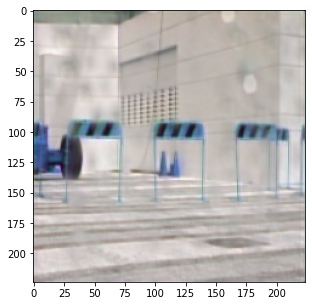

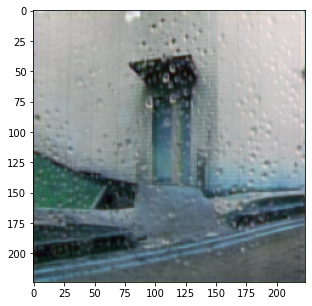

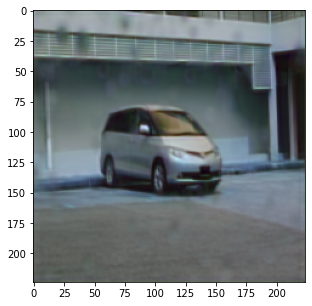

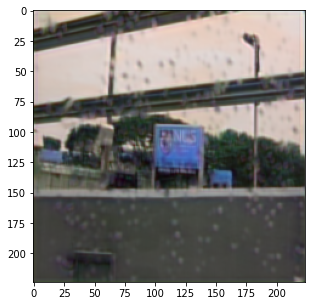

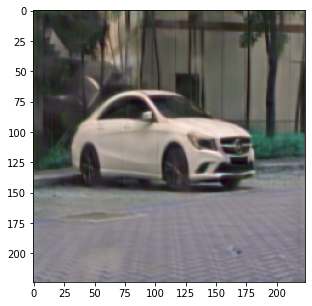

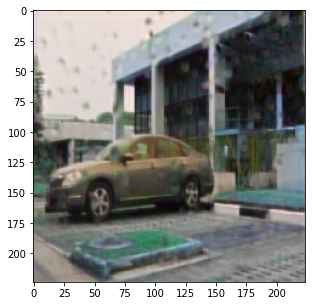

Epoch : 22 , In validation dataset, PSNR is 23.3568 and SSIM is 0.8809
count: 1,loss_G: 0.6323 ,loss_D: 1.3896 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2893 ,loss_ML: 0.0146 ,loss_Att: 0.3215 ,loss_MAP: 0.0033
count: 20,loss_G: 0.5026 ,loss_D: 1.3895 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2115 ,loss_ML: 0.0149 ,loss_Att: 0.2693 ,loss_MAP: 0.0032
count: 40,loss_G: 0.4665 ,loss_D: 1.3886 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1769 ,loss_ML: 0.0129 ,loss_Att: 0.2699 ,loss_MAP: 0.0023
count: 60,loss_G: 0.5380 ,loss_D: 1.3901 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2170 ,loss_ML: 0.0168 ,loss_Att: 0.2973 ,loss_MAP: 0.0038
count: 80,loss_G: 0.5116 ,loss_D: 1.3894 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1940 ,loss_ML: 0.0166 ,loss_Att: 0.2942 ,loss_MAP: 0.0031
count: 100,loss_G: 0.5377 ,loss_D: 1.3893 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2143 ,loss_ML: 0.0163 ,loss_Att: 0.3002 ,loss_MAP: 0.0030
count: 120,loss_G: 0.5575 ,loss_D: 1.3895

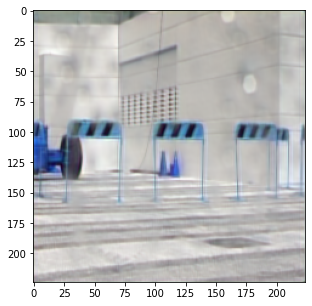

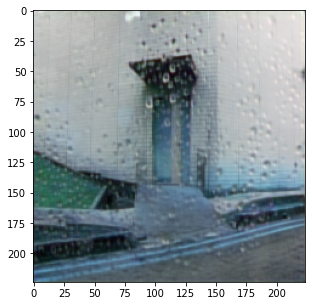

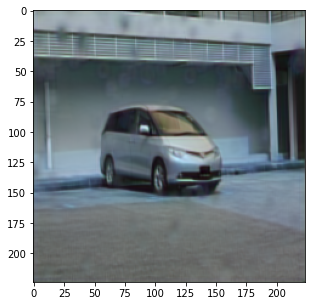

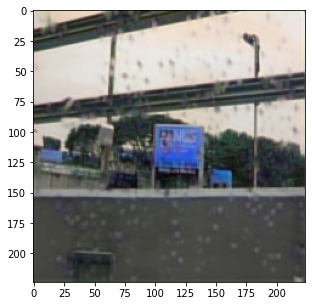

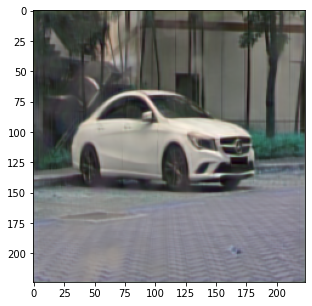

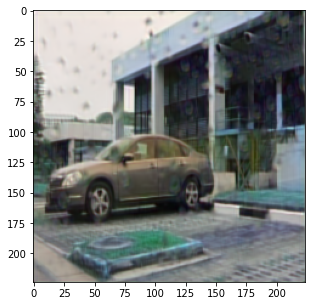

Epoch : 23 , In validation dataset, PSNR is 23.8905 and SSIM is 0.8899
save model !!!!!!!!!!
count: 1,loss_G: 0.3141 ,loss_D: 1.3894 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1160 ,loss_ML: 0.0095 ,loss_Att: 0.1817 ,loss_MAP: 0.0031
count: 20,loss_G: 0.4614 ,loss_D: 1.3892 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1847 ,loss_ML: 0.0127 ,loss_Att: 0.2571 ,loss_MAP: 0.0029
count: 40,loss_G: 0.5074 ,loss_D: 1.3892 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1761 ,loss_ML: 0.0139 ,loss_Att: 0.3106 ,loss_MAP: 0.0029
count: 60,loss_G: 0.5149 ,loss_D: 1.3893 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1960 ,loss_ML: 0.0137 ,loss_Att: 0.2984 ,loss_MAP: 0.0030
count: 80,loss_G: 0.5172 ,loss_D: 1.3902 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1962 ,loss_ML: 0.0160 ,loss_Att: 0.2981 ,loss_MAP: 0.0039
count: 100,loss_G: 0.4421 ,loss_D: 1.3893 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1672 ,loss_ML: 0.0135 ,loss_Att: 0.2545 ,loss_MAP: 0.0030
count: 120,loss_G: 

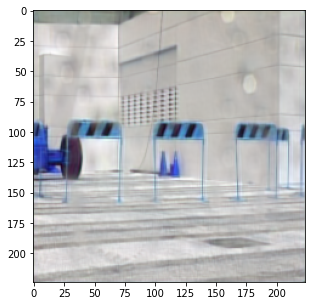

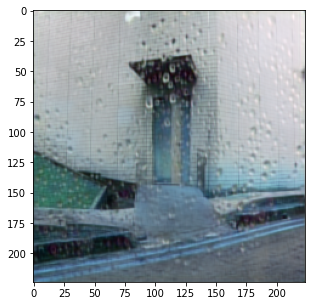

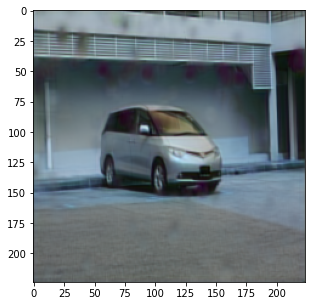

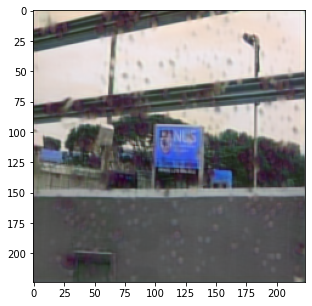

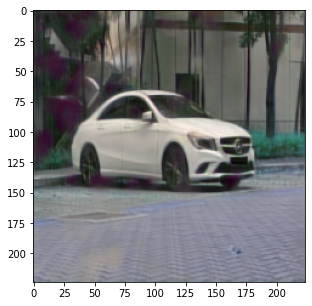

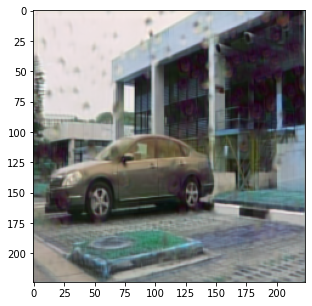

Epoch : 24 , In validation dataset, PSNR is 23.9719 and SSIM is 0.8917
save model !!!!!!!!!!
count: 1,loss_G: 0.5362 ,loss_D: 1.3885 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2217 ,loss_ML: 0.0138 ,loss_Att: 0.2939 ,loss_MAP: 0.0022
count: 20,loss_G: 0.4248 ,loss_D: 1.3884 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1454 ,loss_ML: 0.0140 ,loss_Att: 0.2586 ,loss_MAP: 0.0021
count: 40,loss_G: 0.4959 ,loss_D: 1.3883 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1768 ,loss_ML: 0.0140 ,loss_Att: 0.2983 ,loss_MAP: 0.0020
count: 60,loss_G: 0.4408 ,loss_D: 1.3885 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1741 ,loss_ML: 0.0151 ,loss_Att: 0.2447 ,loss_MAP: 0.0022
count: 80,loss_G: 0.4864 ,loss_D: 1.3887 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1705 ,loss_ML: 0.0143 ,loss_Att: 0.2947 ,loss_MAP: 0.0024
count: 100,loss_G: 0.4343 ,loss_D: 1.3881 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1693 ,loss_ML: 0.0122 ,loss_Att: 0.2459 ,loss_MAP: 0.0018
count: 120,loss_G: 

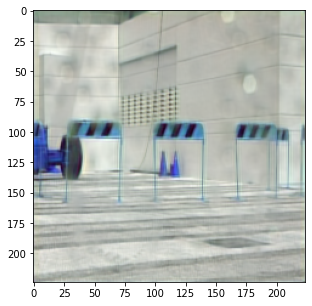

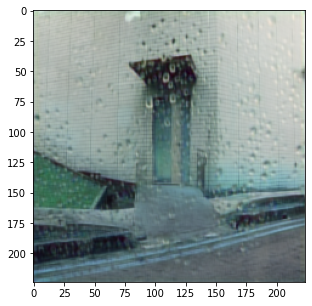

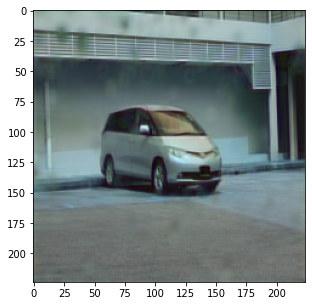

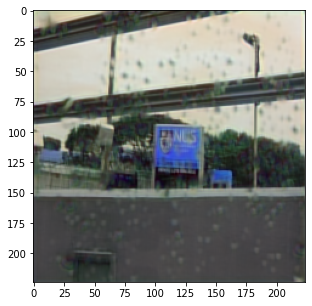

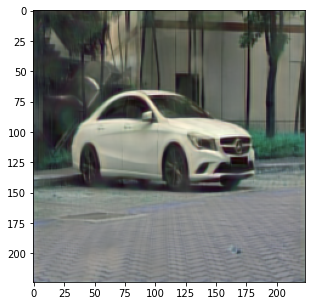

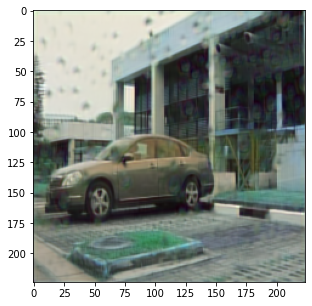

Epoch : 25 , In validation dataset, PSNR is 24.1445 and SSIM is 0.8933
save model !!!!!!!!!!
count: 1,loss_G: 0.5783 ,loss_D: 1.3918 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.2905 ,loss_ML: 0.0190 ,loss_Att: 0.2619 ,loss_MAP: 0.0055
count: 20,loss_G: 0.5076 ,loss_D: 1.3904 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1882 ,loss_ML: 0.0171 ,loss_Att: 0.2955 ,loss_MAP: 0.0041
count: 40,loss_G: 0.5080 ,loss_D: 1.3903 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1830 ,loss_ML: 0.0147 ,loss_Att: 0.3034 ,loss_MAP: 0.0040
count: 60,loss_G: 0.4110 ,loss_D: 1.3890 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1506 ,loss_ML: 0.0125 ,loss_Att: 0.2410 ,loss_MAP: 0.0026
count: 80,loss_G: 0.5388 ,loss_D: 1.3895 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1858 ,loss_ML: 0.0229 ,loss_Att: 0.3233 ,loss_MAP: 0.0031
count: 100,loss_G: 0.3975 ,loss_D: 1.3888 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1515 ,loss_ML: 0.0105 ,loss_Att: 0.2287 ,loss_MAP: 0.0025
count: 120,loss_G: 

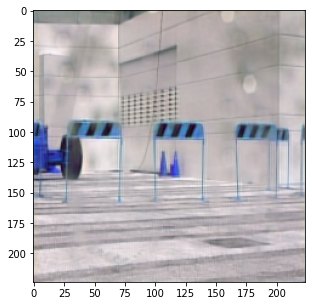

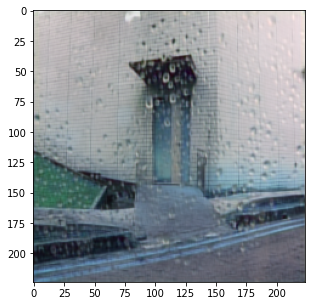

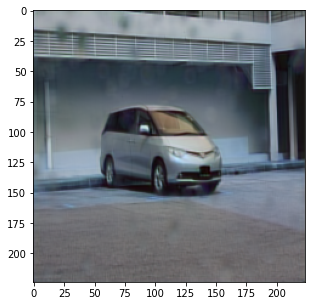

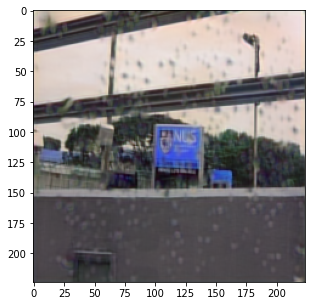

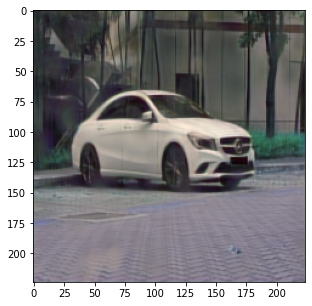

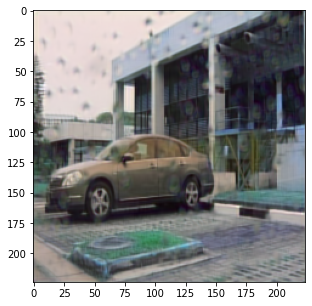

Epoch : 26 , In validation dataset, PSNR is 23.6186 and SSIM is 0.8949
count: 1,loss_G: 0.3677 ,loss_D: 1.3890 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1079 ,loss_ML: 0.0109 ,loss_Att: 0.2421 ,loss_MAP: 0.0027
count: 20,loss_G: 0.5246 ,loss_D: 1.3906 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1853 ,loss_ML: 0.0165 ,loss_Att: 0.3158 ,loss_MAP: 0.0043
count: 40,loss_G: 0.4407 ,loss_D: 1.3887 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1521 ,loss_ML: 0.0141 ,loss_Att: 0.2676 ,loss_MAP: 0.0024
count: 60,loss_G: 0.5242 ,loss_D: 1.3893 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1527 ,loss_ML: 0.0156 ,loss_Att: 0.3490 ,loss_MAP: 0.0030
count: 80,loss_G: 0.3988 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1418 ,loss_ML: 0.0127 ,loss_Att: 0.2374 ,loss_MAP: 0.0026
count: 100,loss_G: 0.4373 ,loss_D: 1.3891 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1638 ,loss_ML: 0.0123 ,loss_Att: 0.2544 ,loss_MAP: 0.0028
count: 120,loss_G: 0.4378 ,loss_D: 1.3897

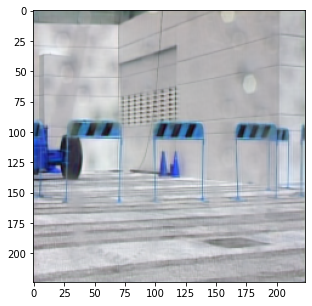

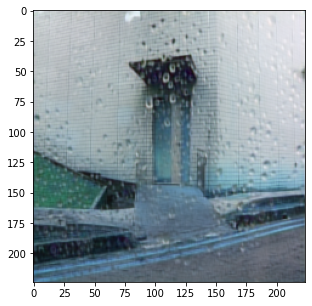

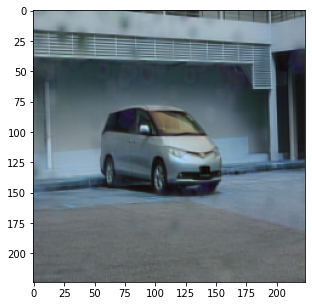

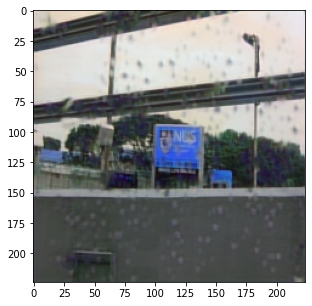

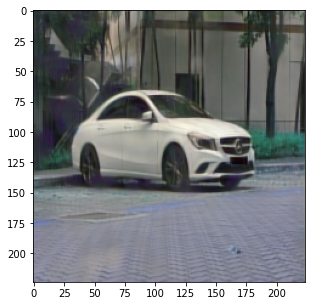

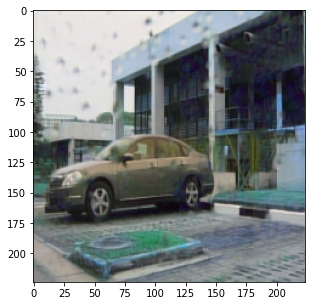

Epoch : 27 , In validation dataset, PSNR is 24.2513 and SSIM is 0.9024
save model !!!!!!!!!!
count: 1,loss_G: 0.4439 ,loss_D: 1.3896 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1828 ,loss_ML: 0.0100 ,loss_Att: 0.2442 ,loss_MAP: 0.0033
count: 20,loss_G: 0.4082 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1478 ,loss_ML: 0.0117 ,loss_Att: 0.2418 ,loss_MAP: 0.0025
count: 40,loss_G: 0.3862 ,loss_D: 1.3886 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1355 ,loss_ML: 0.0109 ,loss_Att: 0.2329 ,loss_MAP: 0.0023
count: 60,loss_G: 0.4328 ,loss_D: 1.3891 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1683 ,loss_ML: 0.0131 ,loss_Att: 0.2445 ,loss_MAP: 0.0028
count: 80,loss_G: 0.4659 ,loss_D: 1.3892 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1602 ,loss_ML: 0.0137 ,loss_Att: 0.2851 ,loss_MAP: 0.0029
count: 100,loss_G: 0.4511 ,loss_D: 1.3888 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1546 ,loss_ML: 0.0132 ,loss_Att: 0.2765 ,loss_MAP: 0.0025
count: 120,loss_G: 

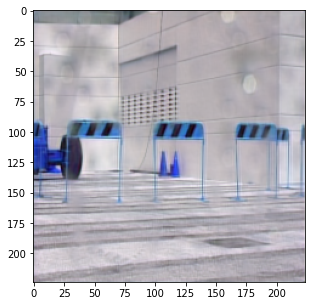

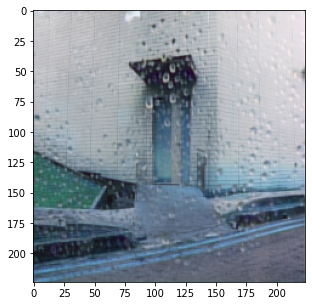

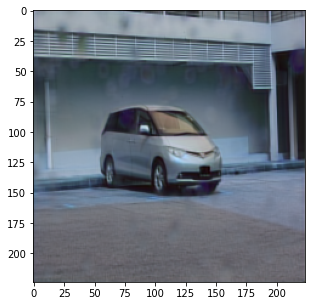

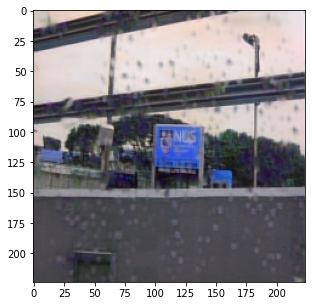

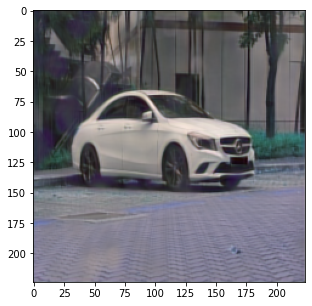

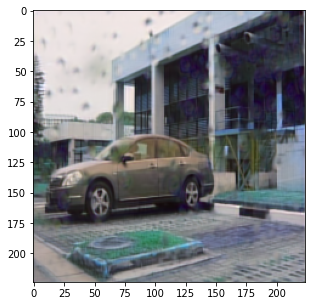

Epoch : 28 , In validation dataset, PSNR is 24.1228 and SSIM is 0.8997
count: 1,loss_G: 0.2859 ,loss_D: 1.3875 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1064 ,loss_ML: 0.0092 ,loss_Att: 0.1635 ,loss_MAP: 0.0012
count: 20,loss_G: 0.3583 ,loss_D: 1.3879 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1226 ,loss_ML: 0.0098 ,loss_Att: 0.2190 ,loss_MAP: 0.0016
count: 40,loss_G: 0.3640 ,loss_D: 1.3883 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1199 ,loss_ML: 0.0094 ,loss_Att: 0.2279 ,loss_MAP: 0.0020
count: 60,loss_G: 0.4848 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1657 ,loss_ML: 0.0145 ,loss_Att: 0.2978 ,loss_MAP: 0.0025
count: 80,loss_G: 0.4143 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1286 ,loss_ML: 0.0122 ,loss_Att: 0.2666 ,loss_MAP: 0.0026
count: 100,loss_G: 0.5401 ,loss_D: 1.3899 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1769 ,loss_ML: 0.0219 ,loss_Att: 0.3344 ,loss_MAP: 0.0036
count: 120,loss_G: 0.5118 ,loss_D: 1.3896

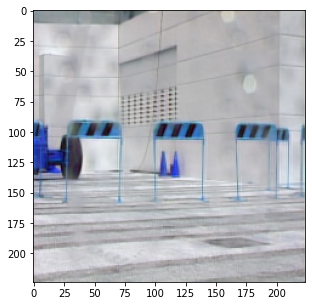

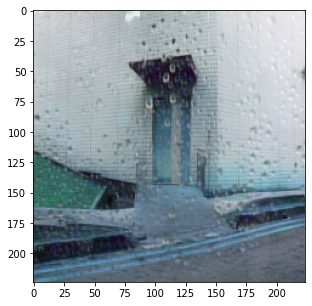

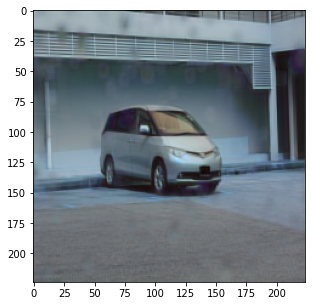

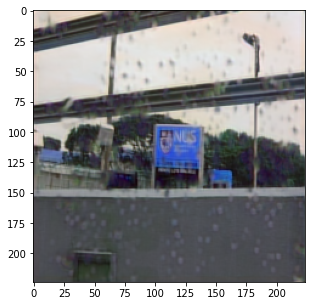

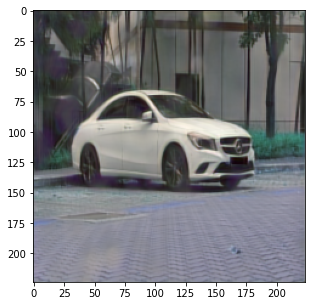

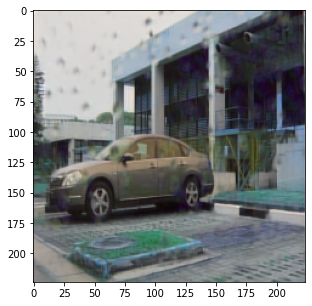

Epoch : 29 , In validation dataset, PSNR is 24.1535 and SSIM is 0.9039
count: 1,loss_G: 0.2004 ,loss_D: 1.3877 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.0695 ,loss_ML: 0.0060 ,loss_Att: 0.1180 ,loss_MAP: 0.0014
count: 20,loss_G: 0.3863 ,loss_D: 1.3884 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1504 ,loss_ML: 0.0097 ,loss_Att: 0.2193 ,loss_MAP: 0.0021
count: 40,loss_G: 0.4019 ,loss_D: 1.3885 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1300 ,loss_ML: 0.0116 ,loss_Att: 0.2534 ,loss_MAP: 0.0022
count: 60,loss_G: 0.4551 ,loss_D: 1.3886 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1512 ,loss_ML: 0.0125 ,loss_Att: 0.2846 ,loss_MAP: 0.0022
count: 80,loss_G: 0.4478 ,loss_D: 1.3884 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1508 ,loss_ML: 0.0112 ,loss_Att: 0.2789 ,loss_MAP: 0.0021
count: 100,loss_G: 0.5181 ,loss_D: 1.3889 ,loss_GANL 0.0069 ,loss_disc: 1.3863 ,loss_PL: 0.1554 ,loss_ML: 0.0148 ,loss_Att: 0.3410 ,loss_MAP: 0.0026
count: 120,loss_G: 0.4933 ,loss_D: 1.3899

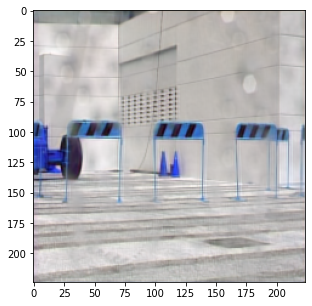

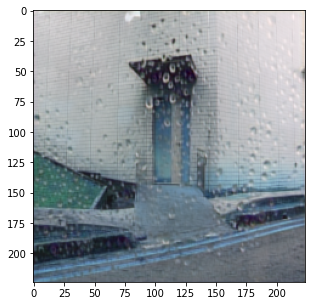

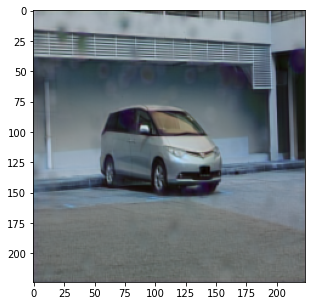

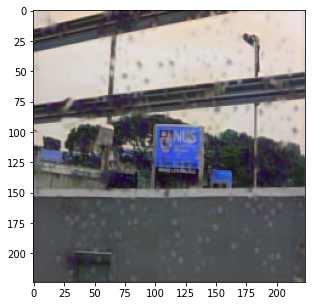

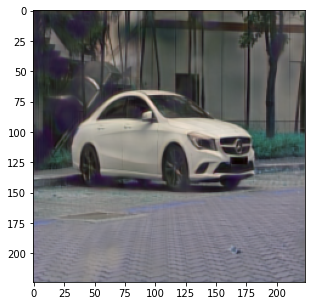

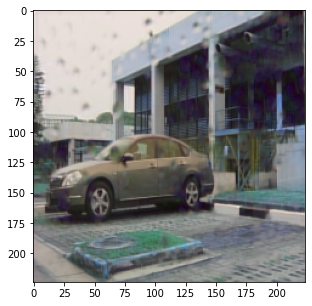

Epoch : 30 , In validation dataset, PSNR is 23.8130 and SSIM is 0.9003


In [ ]:
tr = trainer()
A_,I_,G_losses,D_losses = tr.train_start()

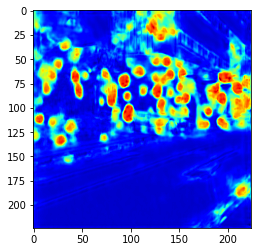

In [ ]:
a=A_[3].cpu()
a=a.detach().numpy()
out=a.transpose((0,2,3,1))
out=out[0,:,:,:]*255.
out=minmax_scale(out)
plt.imshow(out.squeeze(),cmap='jet')
plt.show()

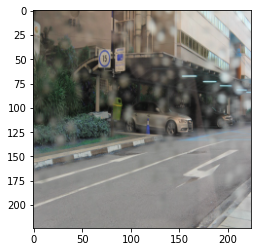

In [ ]:
plt.imshow(I_.squeeze())
plt.show()

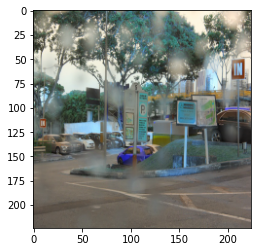

In [ ]:
I_test=I_test.cpu()
I_test=I_test.numpy()
I_test=I_test.transpose((0,2,3,1))
plt.imshow(I_test.squeeze())
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


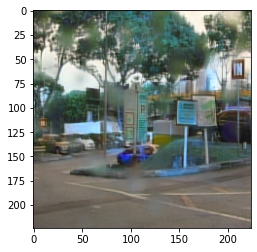

In [ ]:
o=o.cpu()
o=o.numpy()
o=o.transpose((0,2,3,1))
plt.imshow(o.squeeze())
plt.show()

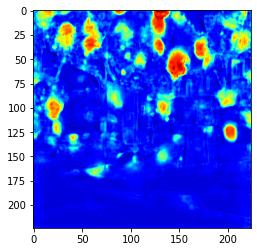

In [ ]:
a=a_[3].cpu()
a=a.detach().numpy()
out=a.transpose((0,2,3,1))
out=out[0,:,:,:]*255.
out=minmax_scale(out)
plt.imshow(out.squeeze(),cmap='jet')
plt.show()